<a href="https://colab.research.google.com/github/OriolFeliu/Compilador/blob/main/mri.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
# IMPORTS
import tensorflow as tf
from tensorflow import keras
print(tf.__version__)
import imageio
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import csv
import cv2
import os
import time
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Dense, Reshape, Conv2DTranspose, BatchNormalization, LeakyReLU
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Dense, Flatten, BatchNormalization, LeakyReLU, Conv2D
"""
!pip install nipype
!pip install pydicom
!pip install opencv-python
!pip install pillow # optional
!pip install pandas
#import nipype
import pydicom as dicom
"""


2.9.2


'\n!pip install nipype\n!pip install pydicom\n!pip install opencv-python\n!pip install pillow # optional\n!pip install pandas\n#import nipype\nimport pydicom as dicom\n'

In [3]:
# /content/drive/MyDrive/UAB/TFG/data/ds003097.zip
# https://stackoverflow.com/questions/47744131/colaboratory-can-i-access-to-my-google-drive-folder-and-file
"""
if os.path.exists('/content/drive/MyDrive/UAB/TFG/data/ds003097') is False:
  !unzip /content/drive/MyDrive/UAB/TFG/data/ds003097.zip
"""

"\nif os.path.exists('/content/drive/MyDrive/UAB/TFG/data/ds003097') is False:\n  !unzip /content/drive/MyDrive/UAB/TFG/data/ds003097.zip\n"

In [4]:
"""
# ALTERNATIVA 1: med2image
# modul per transformar .nii a .jpg
!pip install med2image

# Specify the .nii folder path
folder_path = "/content/drive/MyDrive/UAB/TFG/data/Task01_BrainTumour/imagesTr"
# Specify the .jpg/.png folder path
jpg_folder_path = "/content/drive/MyDrive/UAB/TFG/data/jpgs/test1"
nii_files = os.listdir(folder_path)

for nii_file in nii_files:
  nii_file_path = folder_path + '/' + nii_file
  print(nii_file_path)
  nii_file_jpg = nii_file.split('.')[0] + ".jpg"
  print(jpg_folder_path)
  print(nii_file_jpg)
  #!med2image -i $nii_file_path -d $jpg_folder_path -o $nii_file_jpg --sliceToConvert m
  for i in range(60, 101):
    !med2image -i $nii_file_path -d $jpg_folder_path -o $nii_file_jpg --sliceToConvert $i
"""

'\n# ALTERNATIVA 1: med2image\n# modul per transformar .nii a .jpg\n!pip install med2image\n\n# Specify the .nii folder path\nfolder_path = "/content/drive/MyDrive/UAB/TFG/data/Task01_BrainTumour/imagesTr"\n# Specify the .jpg/.png folder path\njpg_folder_path = "/content/drive/MyDrive/UAB/TFG/data/jpgs/test1"\nnii_files = os.listdir(folder_path)\n\nfor nii_file in nii_files:\n  nii_file_path = folder_path + \'/\' + nii_file\n  print(nii_file_path)\n  nii_file_jpg = nii_file.split(\'.\')[0] + ".jpg"\n  print(jpg_folder_path)\n  print(nii_file_jpg)\n  #!med2image -i $nii_file_path -d $jpg_folder_path -o $nii_file_jpg --sliceToConvert m\n  for i in range(60, 101):\n    !med2image -i $nii_file_path -d $jpg_folder_path -o $nii_file_jpg --sliceToConvert $i\n'

In [5]:
# alternativa 2:

"""
from pathlib import Path
import numpy as np
import nibabel as nib
from skimage import io


def to_uint8(data):
    data -= data.min()
    data /= data.max()
    data *= 255
    return data.astype(np.uint8)


def nii_to_jpgs(input_path, output_dir, rgb=False):
    output_dir = Path(output_dir)
    data = nib.load(input_path).get_fdata()
    *_, num_slices, num_channels = data.shape
    for channel in range(num_channels):
        volume = data[..., channel]
        volume = to_uint8(volume)
        channel_dir = output_dir / f'channel_{channel}'
        channel_dir.mkdir(exist_ok=True, parents=True)
        for slice in range(num_slices):
            slice_data = volume[..., slice]
            if rgb:
                slice_data = np.stack(3 * [slice_data], axis=2)
            output_path = channel_dir / f'channel_{channel}_slice_{slice}.jpg'
            io.imsave(output_path, slice_data)
"""

"\nfrom pathlib import Path\nimport numpy as np\nimport nibabel as nib\nfrom skimage import io\n\n\ndef to_uint8(data):\n    data -= data.min()\n    data /= data.max()\n    data *= 255\n    return data.astype(np.uint8)\n\n\ndef nii_to_jpgs(input_path, output_dir, rgb=False):\n    output_dir = Path(output_dir)\n    data = nib.load(input_path).get_fdata()\n    *_, num_slices, num_channels = data.shape\n    for channel in range(num_channels):\n        volume = data[..., channel]\n        volume = to_uint8(volume)\n        channel_dir = output_dir / f'channel_{channel}'\n        channel_dir.mkdir(exist_ok=True, parents=True)\n        for slice in range(num_slices):\n            slice_data = volume[..., slice]\n            if rgb:\n                slice_data = np.stack(3 * [slice_data], axis=2)\n            output_path = channel_dir / f'channel_{channel}_slice_{slice}.jpg'\n            io.imsave(output_path, slice_data)\n"

In [6]:
"""
nii_to_jpgs("/content/drive/MyDrive/UAB/TFG/data/Task01_BrainTumour/imagesTr/BRATS_001.nii.gz", "/content/drive/MyDrive/UAB/TFG/data/jpgs")

# alternativa 3: nii2png
!pip install nii2png
!chmod +x nii2png.py
!python3 nii2png.py -i /content/drive/MyDrive/UAB/TFG/data/Task01_BrainTumour/imagesTr/BRATS_001.nii.gz -o /content/drive/MyDrive/UAB/TFG/data/jpgs/nii2png
"""

'\nnii_to_jpgs("/content/drive/MyDrive/UAB/TFG/data/Task01_BrainTumour/imagesTr/BRATS_001.nii.gz", "/content/drive/MyDrive/UAB/TFG/data/jpgs")\n\n# alternativa 3: nii2png\n!pip install nii2png\n!chmod +x nii2png.py\n!python3 nii2png.py -i /content/drive/MyDrive/UAB/TFG/data/Task01_BrainTumour/imagesTr/BRATS_001.nii.gz -o /content/drive/MyDrive/UAB/TFG/data/jpgs/nii2png\n'

In [10]:
import random

# GAN
#(train_images, _), (_, _) = tf.keras.datasets.mnist.load_data()
jpg_folder_path = "/content/drive/MyDrive/UAB/TFG/data/jpgs/test1"
#jpg_folder_path = "/content/drive/MyDrive/UAB/TFG/data/jpgs/small_dataset"

jpg_files = os.listdir(jpg_folder_path) # canviar -> es massa pesat per la base de dades tant gran
print(jpg_files.count())
random.shuffle(jpg_files)

mri_images = []

n_samples = 20000
i = 0

for jpg_file in jpg_files: # aqui es podria fer un shuffle de les dades
  if i == n_samples:
    break
  # read image
  mri_image = cv2.imread(jpg_folder_path + '/' + jpg_file, 0)

  # resize
  width = 120
  height = 120
  dim = (width, height)

  mri_image_resized = cv2.resize(mri_image, dim)
 
  # append to array
  mri_images.append(mri_image_resized)
  i += 1

mri_images = np.asarray(mri_images)
mri_images.shape

(20000, 120, 120)

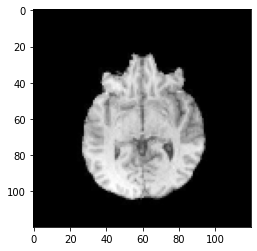

In [11]:
plt.imshow(mri_images[0], cmap='gray')

In [12]:
#print(mri_images.shape[0])
#print(mri_images[70][120])
train_images = mri_images.reshape(mri_images.shape[0], 120, 120, 1).astype('float32')

train_images = (train_images - 127.5) / 127.5

BUFFER_SIZE = 6000
BATCH_SIZE = 16
train_dataset = tf.data.Dataset.from_tensor_slices(train_images).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

print(train_images.shape)
print(np.min(train_images))
print(np.max(train_images))

(20000, 120, 120, 1)
-1.0
1.0


In [13]:
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Dense, Reshape, Conv2DTranspose, BatchNormalization, LeakyReLU

def make_generator_model():
    model = Sequential()
    model.add(Dense(30*30*256, use_bias=False, input_shape=(100,)))

    model.add(Reshape((30, 30, 256)))

    model.add(Conv2DTranspose(128, (5, 5), strides=(2, 2), padding='same'))
    model.add(BatchNormalization())
    model.add(LeakyReLU(alpha=0.01))

    model.add(Conv2DTranspose(64, (5, 5), strides=(1, 1), padding='same'))
    model.add(BatchNormalization())
    model.add(LeakyReLU(alpha=0.01))

    model.add(Conv2DTranspose(1, (5, 5), strides=(2, 2), padding='same', activation='tanh'))

    return model

In [14]:
generator = make_generator_model()
generator.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 230400)            23040000  
                                                                 
 reshape (Reshape)           (None, 30, 30, 256)       0         
                                                                 
 conv2d_transpose (Conv2DTra  (None, 60, 60, 128)      819328    
 nspose)                                                         
                                                                 
 batch_normalization (BatchN  (None, 60, 60, 128)      512       
 ormalization)                                                   
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 60, 60, 128)       0         
                                                                 
 conv2d_transpose_1 (Conv2DT  (None, 60, 60, 64)       2

(1, 120, 120, 1)


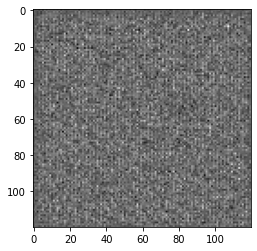

In [15]:
noise_dim = 100
noise = tf.random.normal([1, noise_dim])
generated_image = generator(noise, training=False)

print(generated_image.shape)

plt.imshow(generated_image[0, :, :, 0], cmap='gray')

In [16]:
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Dense, Flatten, BatchNormalization, LeakyReLU, Conv2D

def make_discriminator_model():
    model = Sequential()
    model.add(Conv2D(32, (5, 5), strides=(2, 2), padding='same',
                                     input_shape=[120, 120, 1]))
    model.add(LeakyReLU(alpha=0.01))

    model.add(Conv2D(64, (5, 5), strides=(2, 2), padding='same'))
    model.add(BatchNormalization())
    model.add(LeakyReLU(alpha=0.01))

    model.add(Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
    model.add(BatchNormalization())
    model.add(LeakyReLU(alpha=0.01))

    model.add(Flatten())
    model.add(Dense(1, activation='sigmoid'))

    return model

In [17]:
discriminator = make_discriminator_model()
decision = discriminator(generated_image)
print (decision)

discriminator.summary()

tf.Tensor([[0.50012666]], shape=(1, 1), dtype=float32)
Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 60, 60, 32)        832       
                                                                 
 leaky_re_lu_2 (LeakyReLU)   (None, 60, 60, 32)        0         
                                                                 
 conv2d_1 (Conv2D)           (None, 30, 30, 64)        51264     
                                                                 
 batch_normalization_2 (Batc  (None, 30, 30, 64)       256       
 hNormalization)                                                 
                                                                 
 leaky_re_lu_3 (LeakyReLU)   (None, 30, 30, 64)        0         
                                                                 
 conv2d_2 (Conv2D)           (None, 15, 15, 128)       204928    

In [18]:
generated_image.shape

TensorShape([1, 120, 120, 1])

In [19]:
train_images.shape

(20000, 120, 120, 1)

In [20]:
#decision = discriminator(train_images)
#print (decision)


In [21]:
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

In [22]:
def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

In [23]:
def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

In [24]:
generator_optimizer = tf.keras.optimizers.Adam(1e-4)

discriminator_optimizer = tf.keras.optimizers.Adam(1e-4)

In [25]:
@tf.function
def train_step(images):
    noise = tf.random.normal([BATCH_SIZE, noise_dim])

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
      generated_images = generator(noise, training=True)

      real_output = discriminator(images, training=True)
      fake_output = discriminator(generated_images, training=True)

      gen_loss = generator_loss(fake_output)
      disc_loss = discriminator_loss(real_output, fake_output)

    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

    return gen_loss, disc_loss


In [26]:
import time

grid_size_x= 10
grid_size_y= 10
seed = tf.random.normal([grid_size_x*grid_size_y , noise_dim])

def train(dataset, epochs):
  # arrays to save model's loss
  gen_loss_array = np.zeros([epochs], dtype=float)
  disc_loss_array = np.zeros([epochs], dtype=float)

  for epoch in range(epochs):
    start = time.time()

    for image_batch in dataset:
      gen_loss, disc_loss = train_step(image_batch)

    generate_images(generator,seed)
    print("Generator loss: ")
    print(gen_loss.numpy())
    gen_loss_array[epoch] = gen_loss.numpy()

    print("Discriminator loss: ")
    print(disc_loss.numpy())
    disc_loss_array[epoch] = disc_loss.numpy()

    print ('Time for epoch {} is {} sec'.format(epoch + 1, time.time()-start))

  generate_images(generator, seed)

  return gen_loss_array, disc_loss_array

In [27]:
def generate_images(model, test_input):

  predictions = model(test_input, training=False)

  fig = plt.figure(figsize=(grid_size_x,grid_size_y))
  for i in range(predictions.shape[0]):
      plt.subplot(grid_size_x, grid_size_y, i+1)
      plt.imshow(predictions[i, :, :, 0] * 127.5 + 127.5, cmap='gray')
      plt.axis('off')
  
  plt.show()

/usr/local/lib/python3.8/dist-packages/tensorflow/python/util/dispatch.py:1082: UserWarning: "`binary_crossentropy` received `from_logits=True`, but the `output` argument was produced by a sigmoid or softmax activation and thus does not represent logits. Was this intended?"
  return dispatch_target(*args, **kwargs)


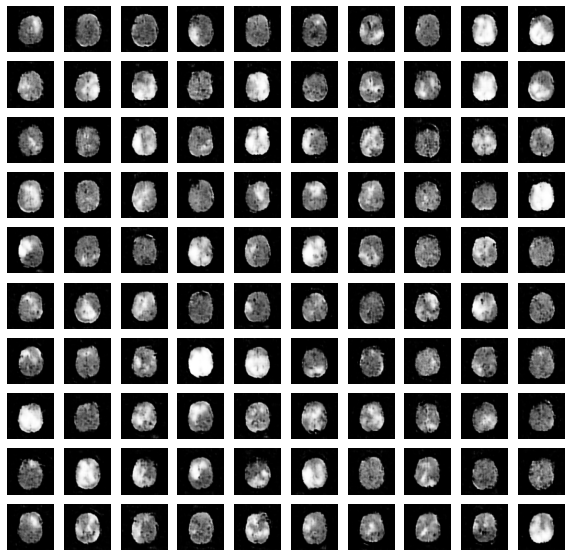

Generator loss: 
0.6507117
Discriminator loss: 
1.2955067
Time for epoch 1 is 71.41336584091187 sec


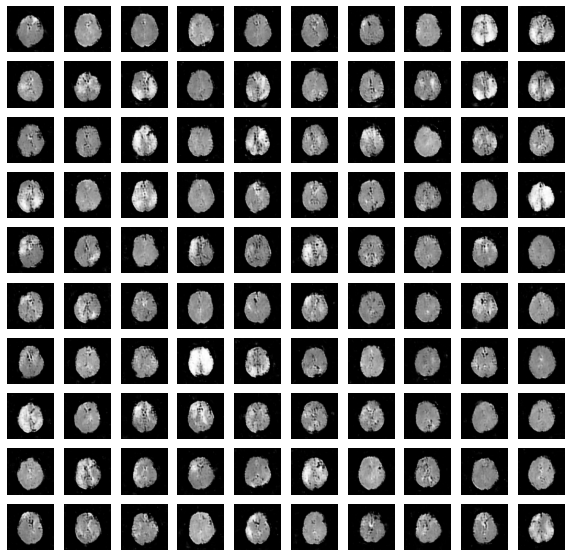

Generator loss: 
0.52222085
Discriminator loss: 
1.6012423
Time for epoch 2 is 70.93605709075928 sec


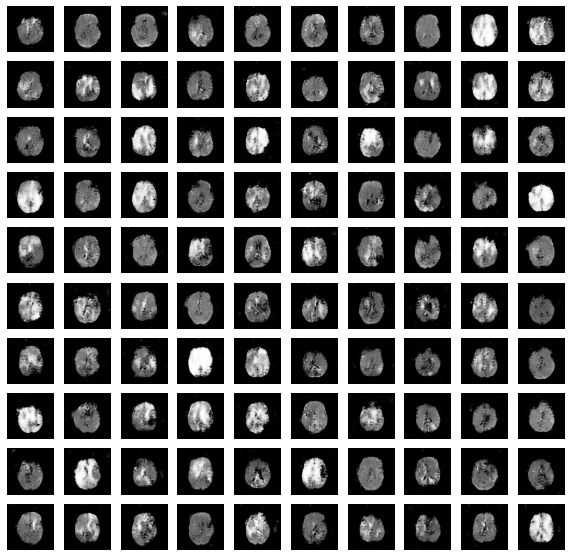

Generator loss: 
1.1987075
Discriminator loss: 
1.480603
Time for epoch 3 is 70.44893527030945 sec


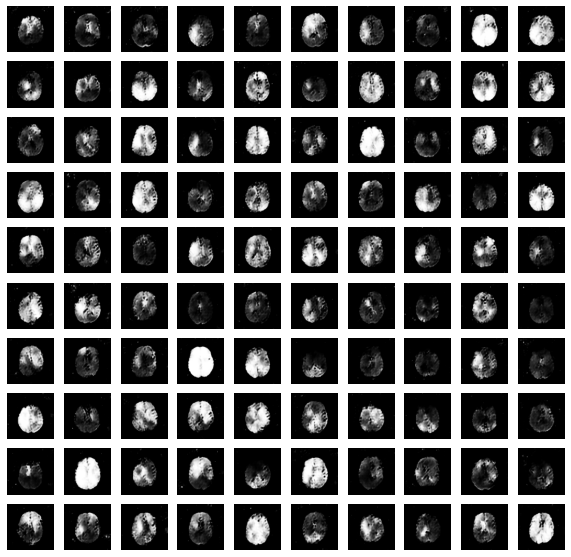

Generator loss: 
1.0825102
Discriminator loss: 
1.1120398
Time for epoch 4 is 70.32581305503845 sec


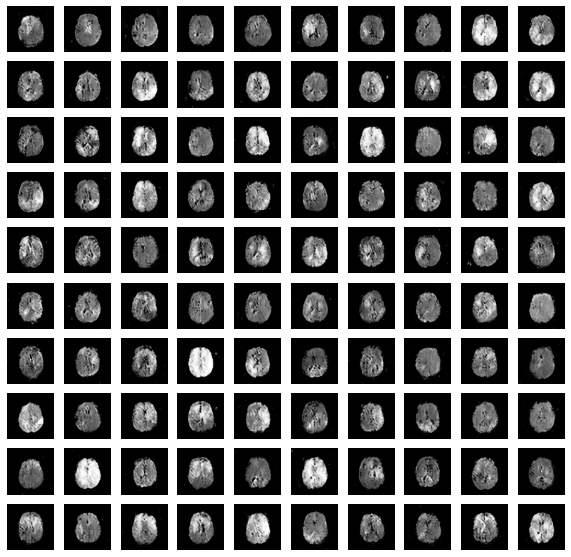

Generator loss: 
0.71110636
Discriminator loss: 
2.0053186
Time for epoch 5 is 70.12944531440735 sec


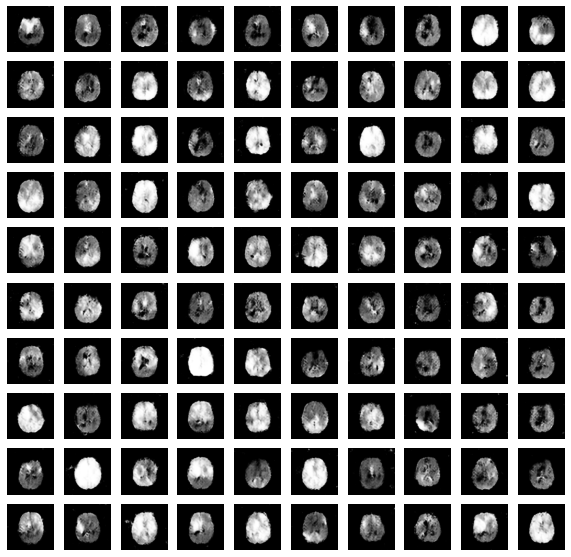

Generator loss: 
0.9870552
Discriminator loss: 
0.8334031
Time for epoch 6 is 70.39622235298157 sec


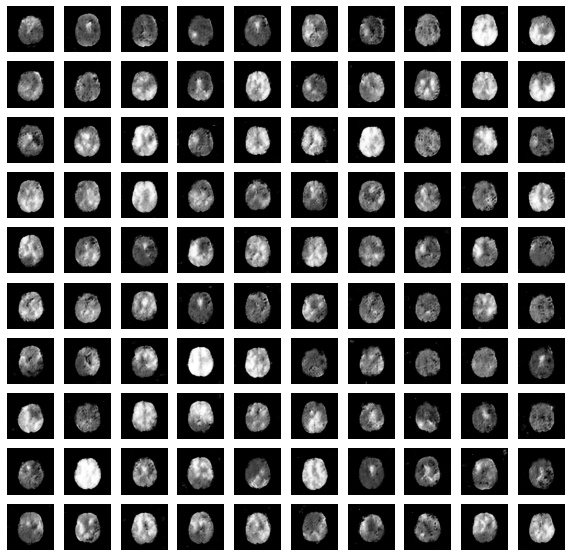

Generator loss: 
0.5165642
Discriminator loss: 
1.3405921
Time for epoch 7 is 70.25133609771729 sec


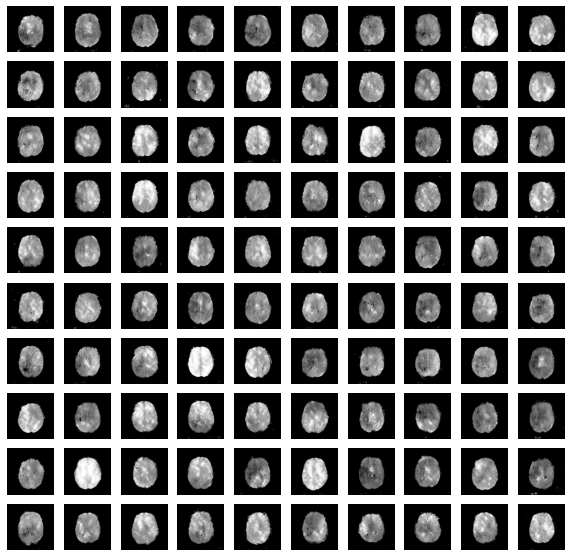

Generator loss: 
0.9176303
Discriminator loss: 
1.2461886
Time for epoch 8 is 70.18216276168823 sec


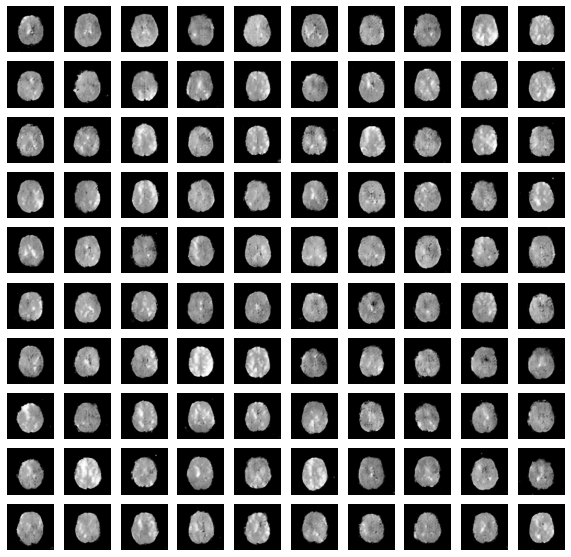

Generator loss: 
1.2409589
Discriminator loss: 
0.6875223
Time for epoch 9 is 70.3799057006836 sec


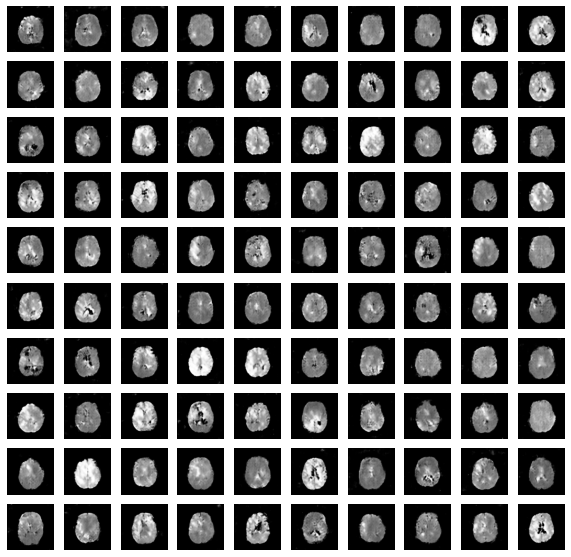

Generator loss: 
0.93844634
Discriminator loss: 
0.95275706
Time for epoch 10 is 70.2293951511383 sec


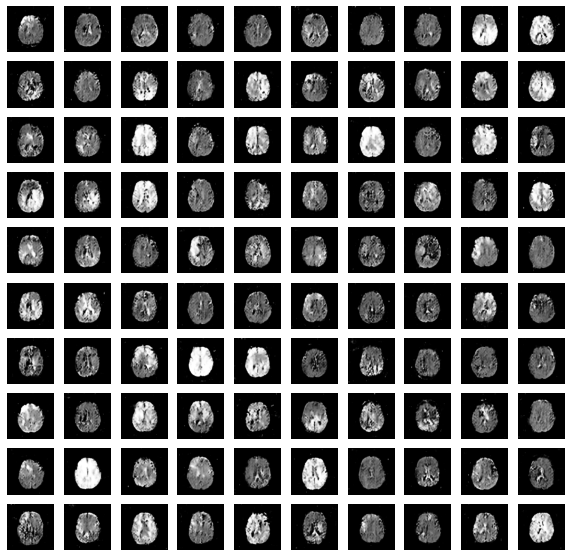

Generator loss: 
0.6555542
Discriminator loss: 
1.8577907
Time for epoch 11 is 70.35929679870605 sec


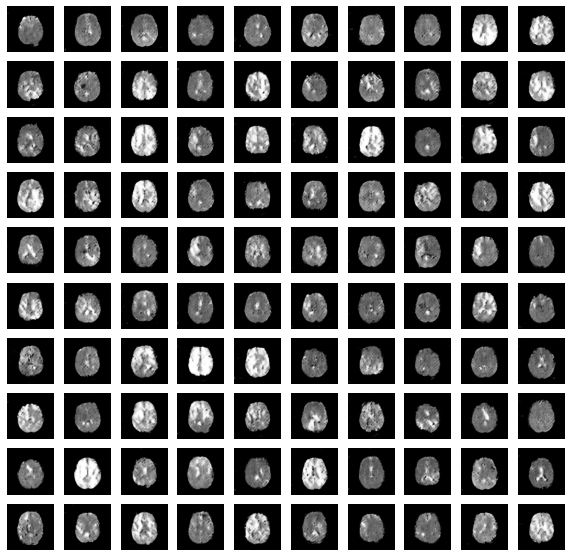

Generator loss: 
0.34136206
Discriminator loss: 
1.5228137
Time for epoch 12 is 70.15731287002563 sec


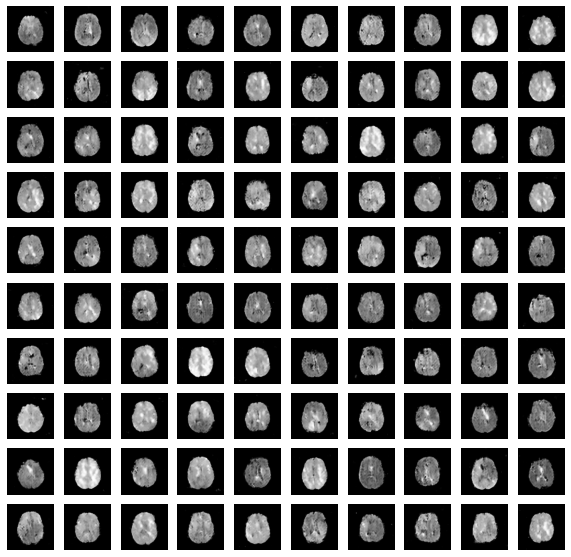

Generator loss: 
0.4709107
Discriminator loss: 
1.7757776
Time for epoch 13 is 70.38882803916931 sec


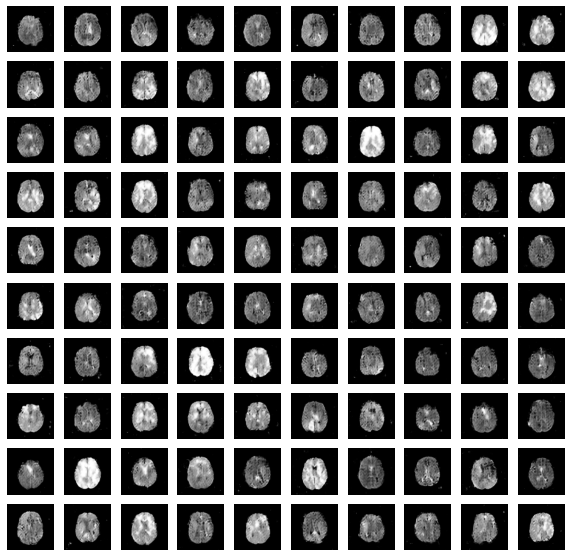

Generator loss: 
0.6336536
Discriminator loss: 
1.9342387
Time for epoch 14 is 70.16355204582214 sec


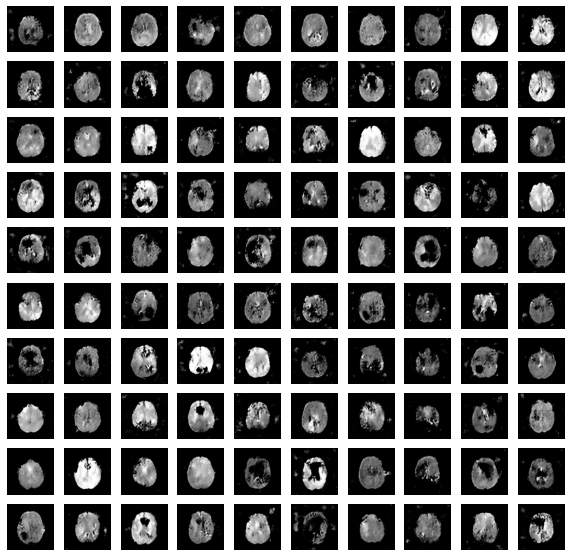

Generator loss: 
1.1670396
Discriminator loss: 
0.6633196
Time for epoch 15 is 70.19239616394043 sec


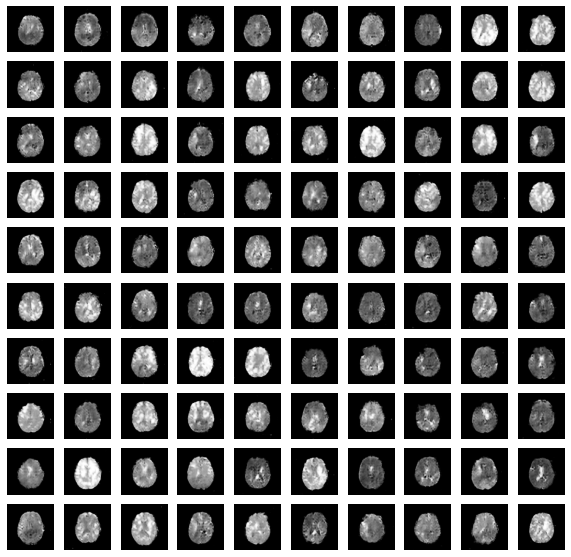

Generator loss: 
1.5038126
Discriminator loss: 
1.7719592
Time for epoch 16 is 70.31421875953674 sec


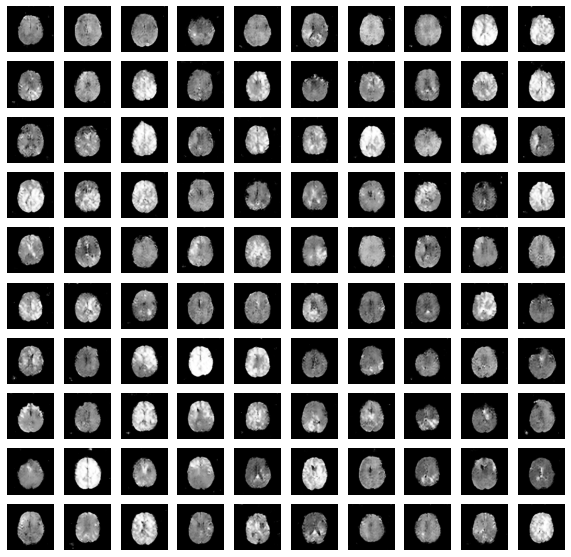

Generator loss: 
0.65030754
Discriminator loss: 
1.5727028
Time for epoch 17 is 70.21541333198547 sec


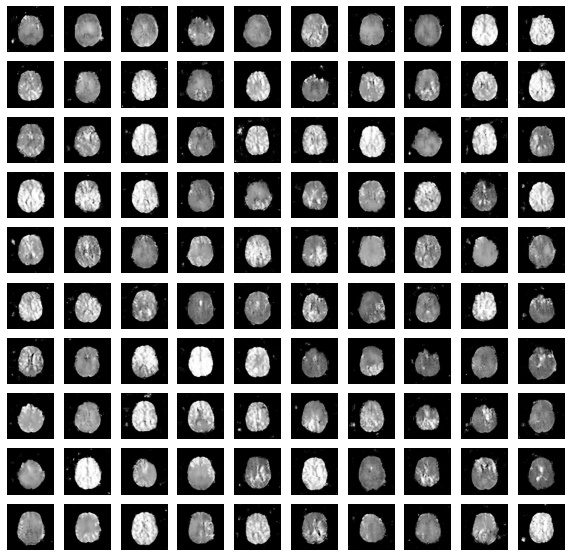

Generator loss: 
0.5671984
Discriminator loss: 
1.8289193
Time for epoch 18 is 70.31001782417297 sec


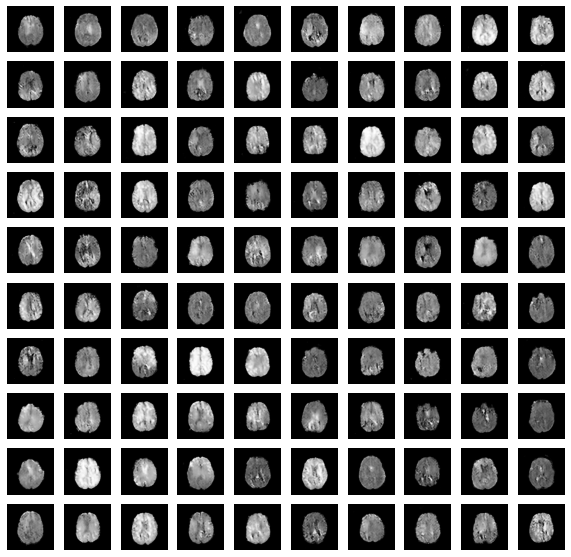

Generator loss: 
1.3796715
Discriminator loss: 
0.877414
Time for epoch 19 is 70.1871964931488 sec


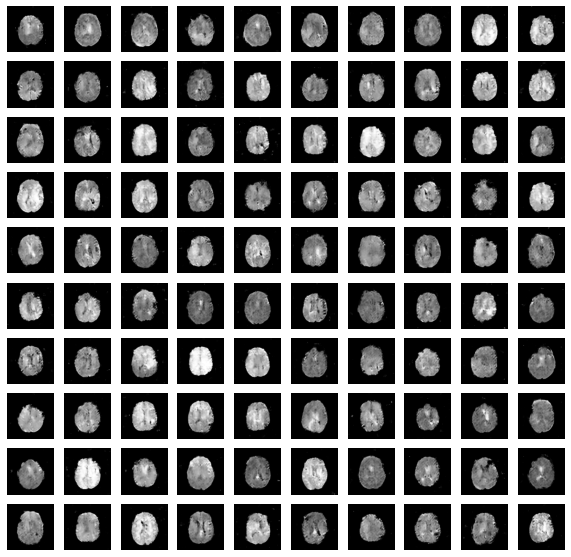

Generator loss: 
0.4795834
Discriminator loss: 
1.7264344
Time for epoch 20 is 70.3165807723999 sec


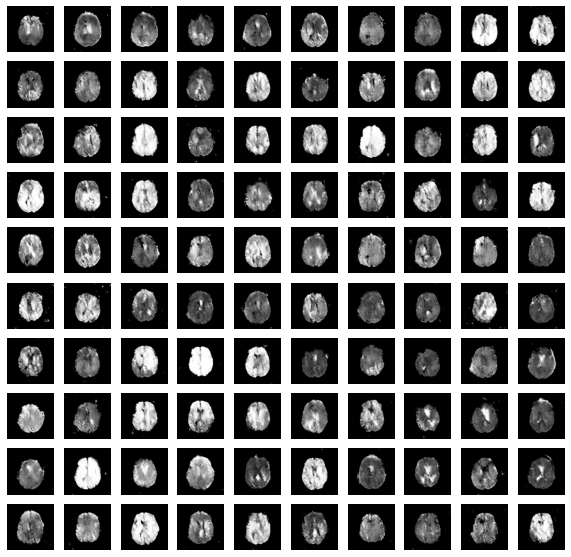

Generator loss: 
0.5873649
Discriminator loss: 
1.4086179
Time for epoch 21 is 70.17900609970093 sec


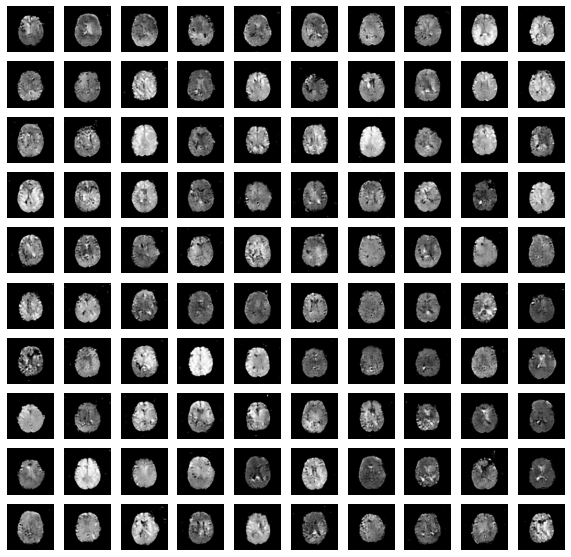

Generator loss: 
1.3901019
Discriminator loss: 
1.1769941
Time for epoch 22 is 70.20001912117004 sec


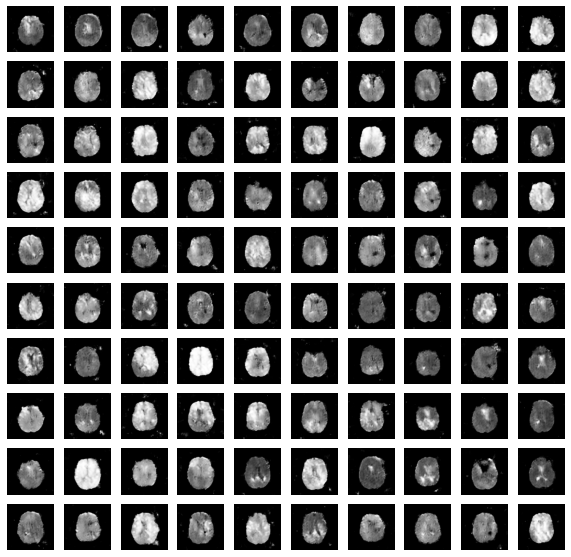

Generator loss: 
0.92679894
Discriminator loss: 
1.8017014
Time for epoch 23 is 70.33957529067993 sec


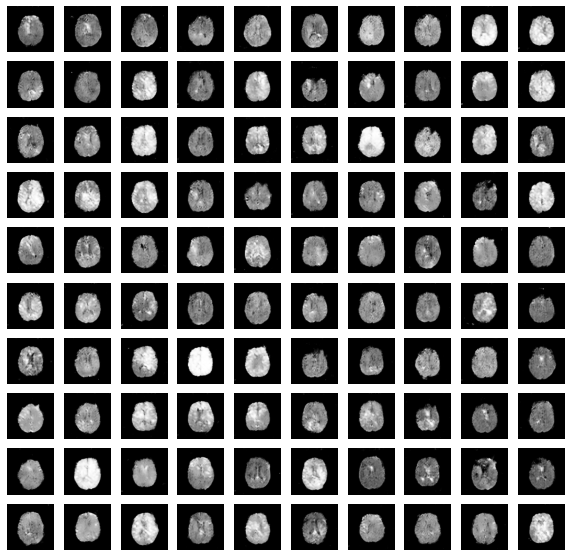

Generator loss: 
1.0392923
Discriminator loss: 
0.9023135
Time for epoch 24 is 70.14476943016052 sec


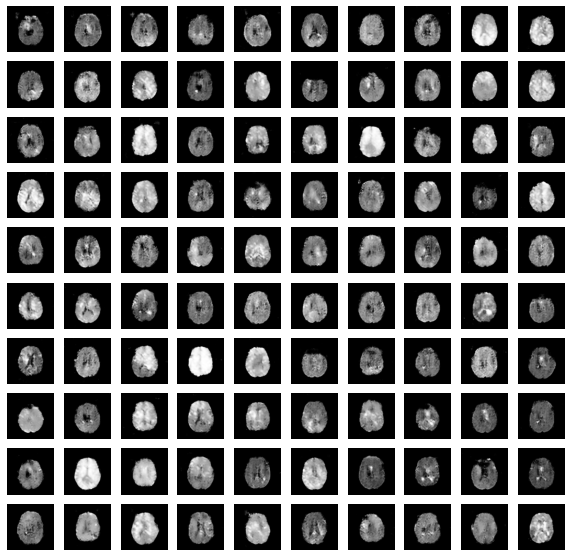

Generator loss: 
0.258192
Discriminator loss: 
1.8499078
Time for epoch 25 is 70.40090203285217 sec


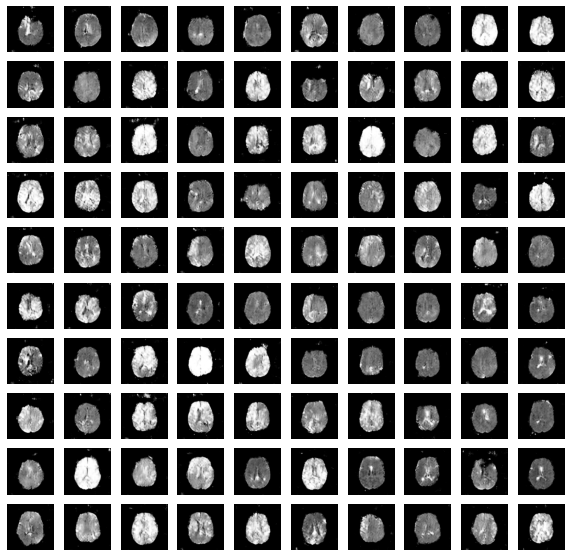

Generator loss: 
0.54911995
Discriminator loss: 
1.8760781
Time for epoch 26 is 70.2395691871643 sec


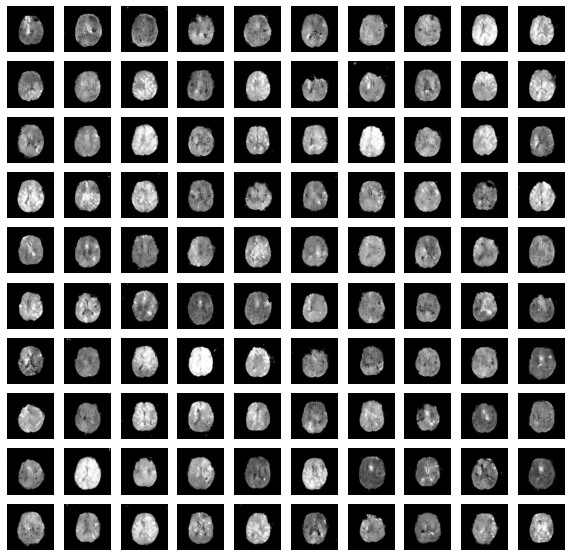

Generator loss: 
1.3930709
Discriminator loss: 
1.0518918
Time for epoch 27 is 70.32479810714722 sec


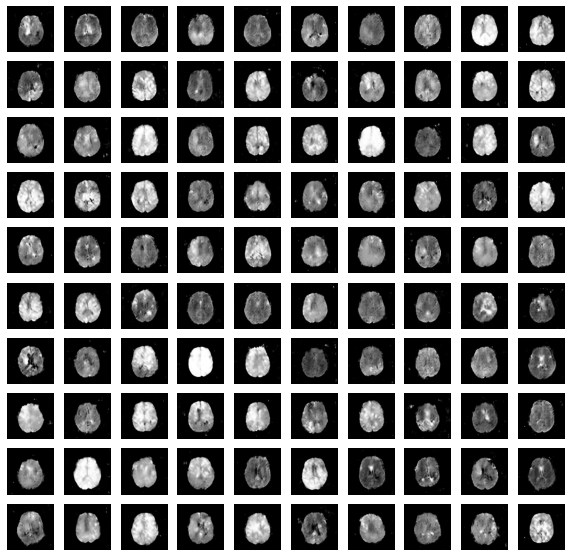

Generator loss: 
1.2892554
Discriminator loss: 
1.0917944
Time for epoch 28 is 70.1866180896759 sec


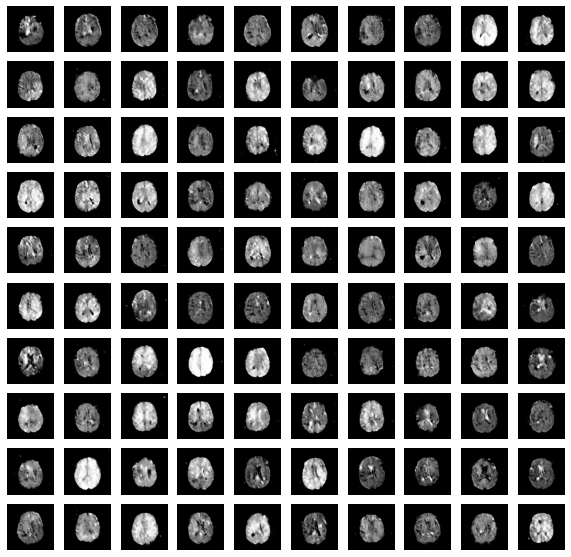

Generator loss: 
0.47890085
Discriminator loss: 
1.3329802
Time for epoch 29 is 70.11375260353088 sec


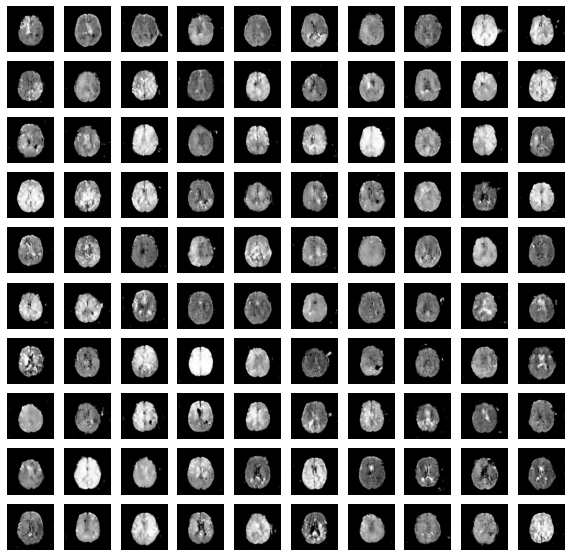

Generator loss: 
0.7776711
Discriminator loss: 
1.0006361
Time for epoch 30 is 70.31748819351196 sec


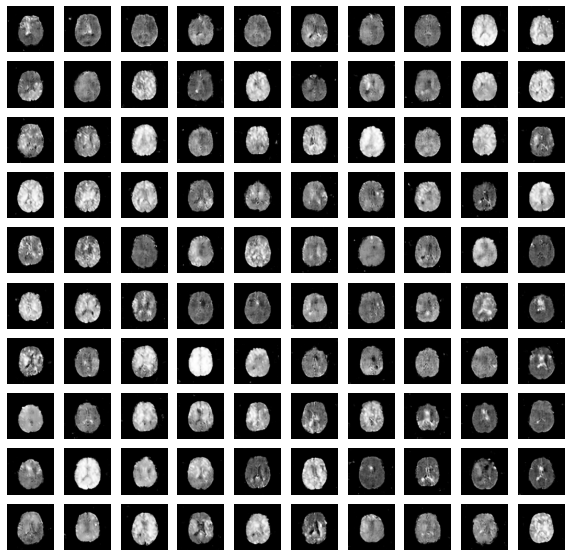

Generator loss: 
0.65266556
Discriminator loss: 
1.3370283
Time for epoch 31 is 70.18817067146301 sec


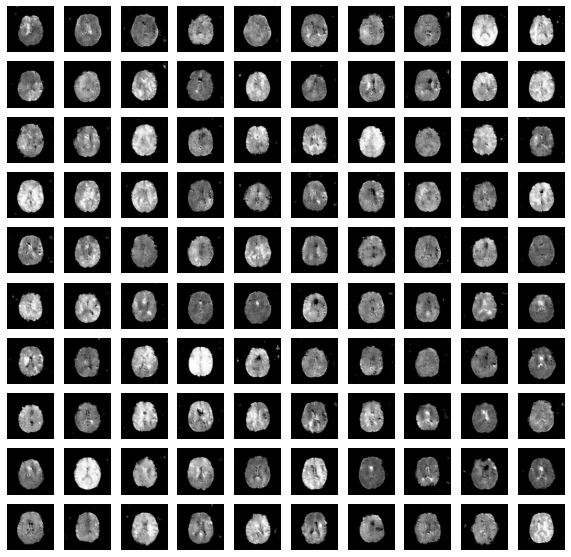

Generator loss: 
1.1351225
Discriminator loss: 
1.0965024
Time for epoch 32 is 70.31557202339172 sec


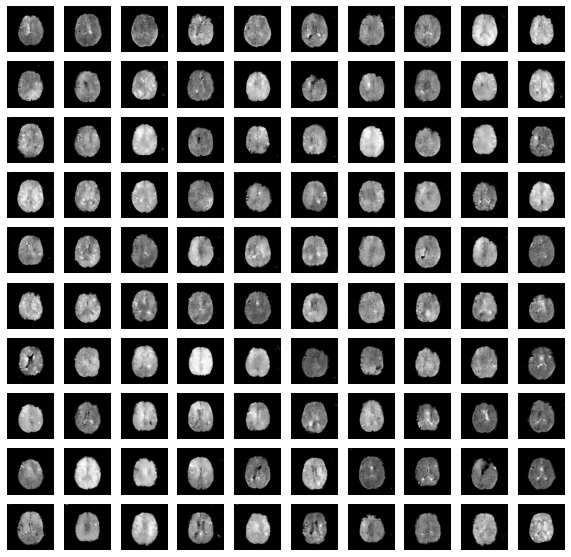

Generator loss: 
0.8265094
Discriminator loss: 
1.2354704
Time for epoch 33 is 70.2528669834137 sec


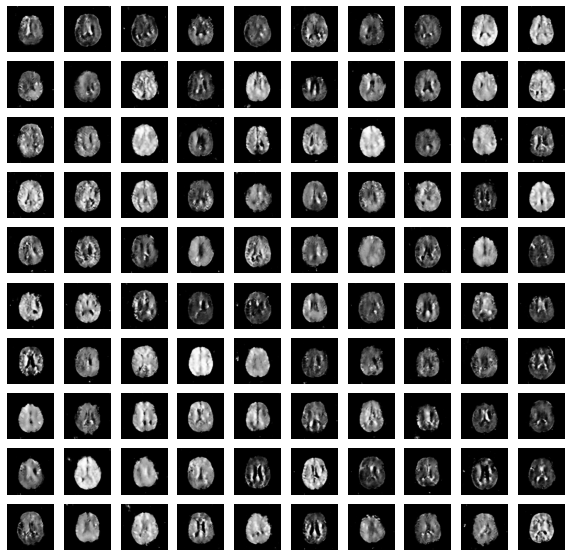

Generator loss: 
0.76666415
Discriminator loss: 
1.4647725
Time for epoch 34 is 70.40879106521606 sec


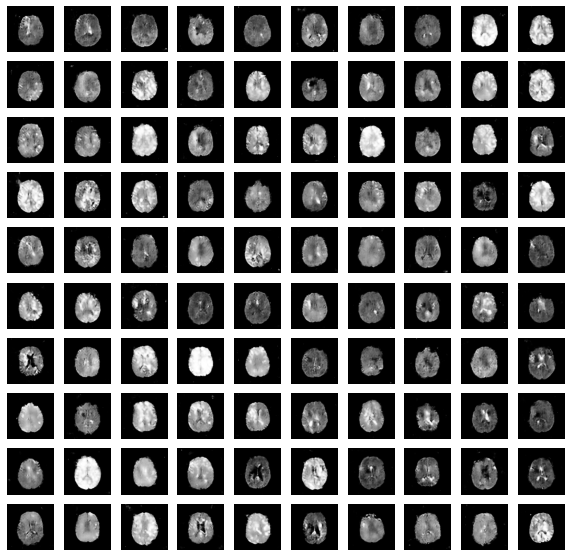

Generator loss: 
0.86275876
Discriminator loss: 
1.5207555
Time for epoch 35 is 70.60485672950745 sec


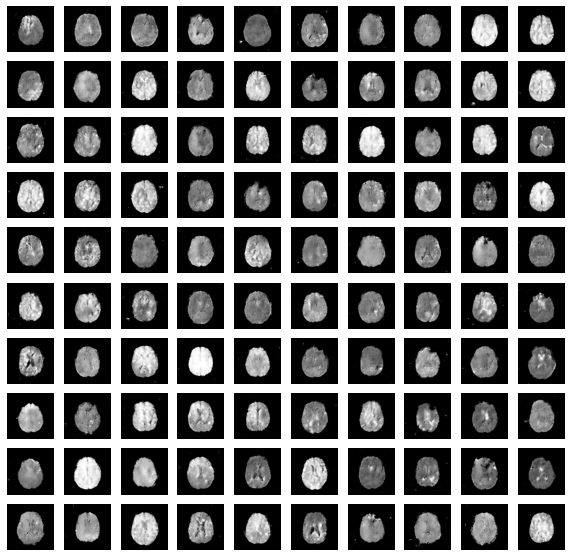

Generator loss: 
0.47635365
Discriminator loss: 
1.8675075
Time for epoch 36 is 70.2600245475769 sec


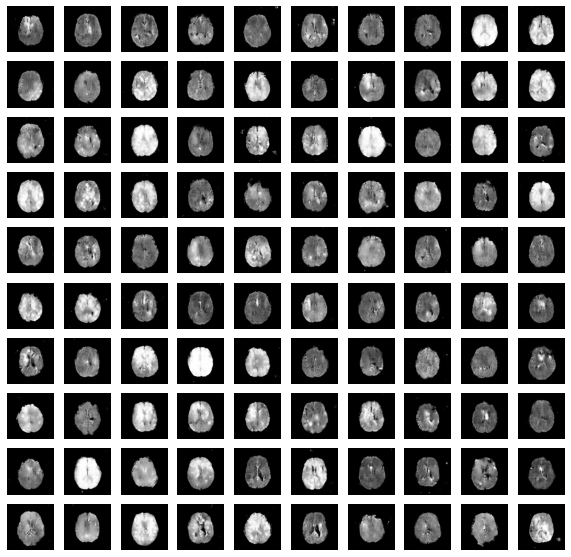

Generator loss: 
0.6531402
Discriminator loss: 
1.6581268
Time for epoch 37 is 70.33564972877502 sec


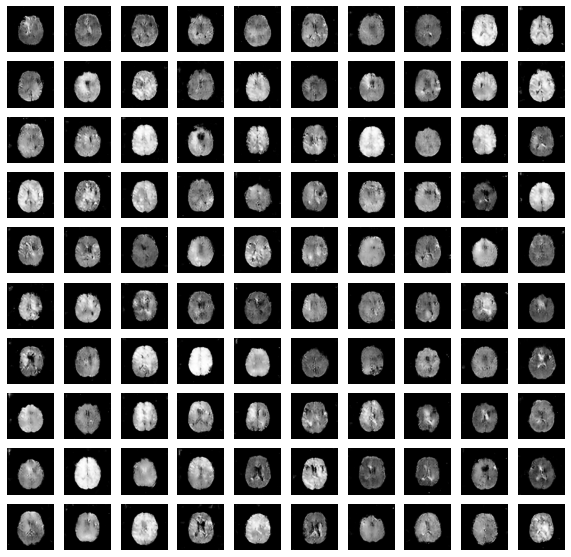

Generator loss: 
0.690268
Discriminator loss: 
1.2745993
Time for epoch 38 is 70.18259692192078 sec


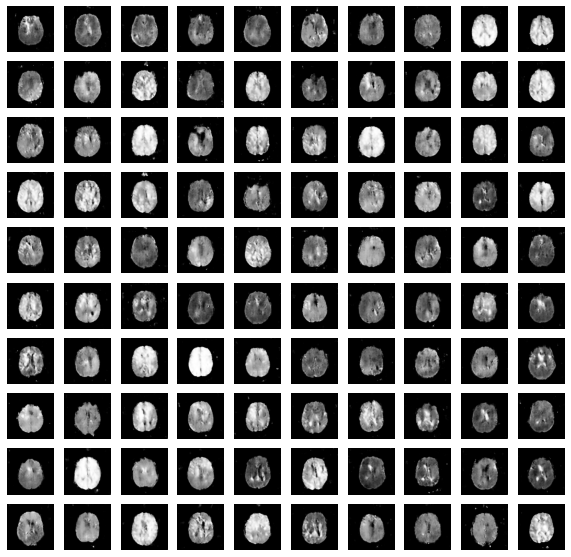

Generator loss: 
0.63236547
Discriminator loss: 
1.4597028
Time for epoch 39 is 70.44043326377869 sec


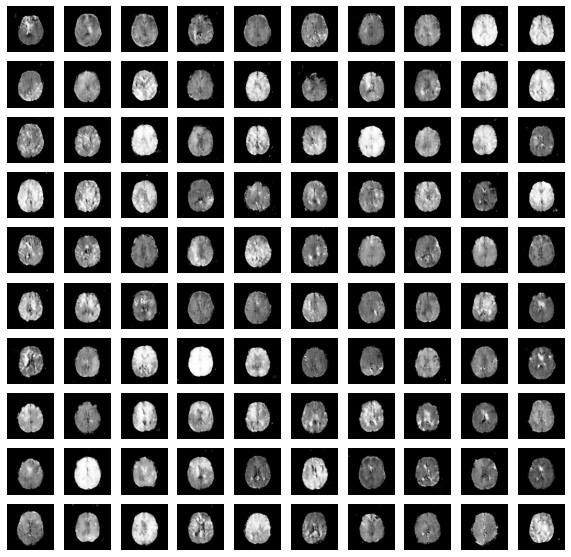

Generator loss: 
0.6581505
Discriminator loss: 
1.7108145
Time for epoch 40 is 70.28143811225891 sec


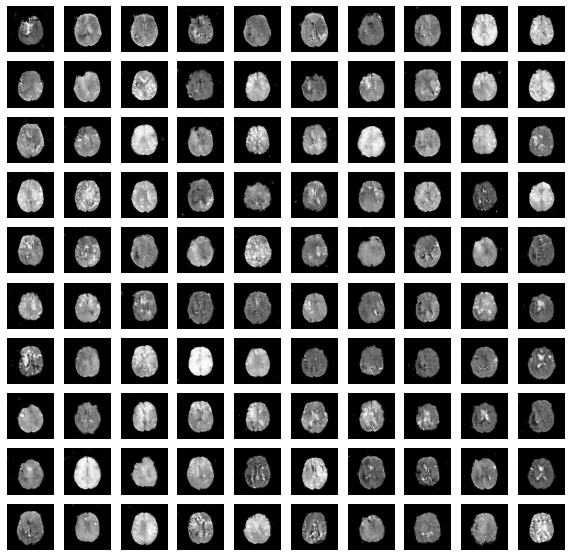

Generator loss: 
0.652531
Discriminator loss: 
1.6572441
Time for epoch 41 is 70.43496513366699 sec


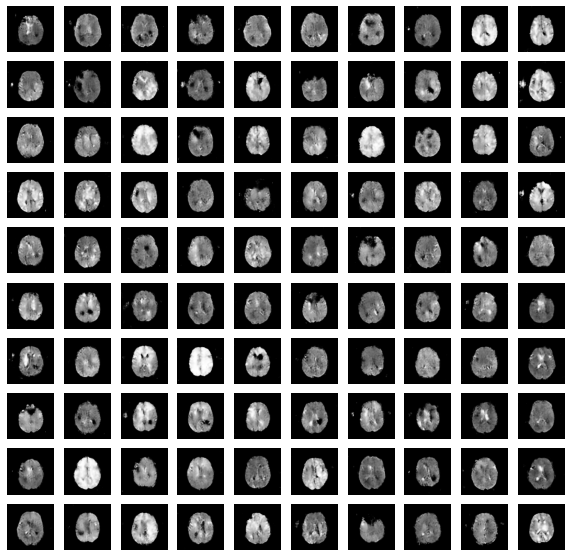

Generator loss: 
0.53631306
Discriminator loss: 
1.5096581
Time for epoch 42 is 70.31293988227844 sec


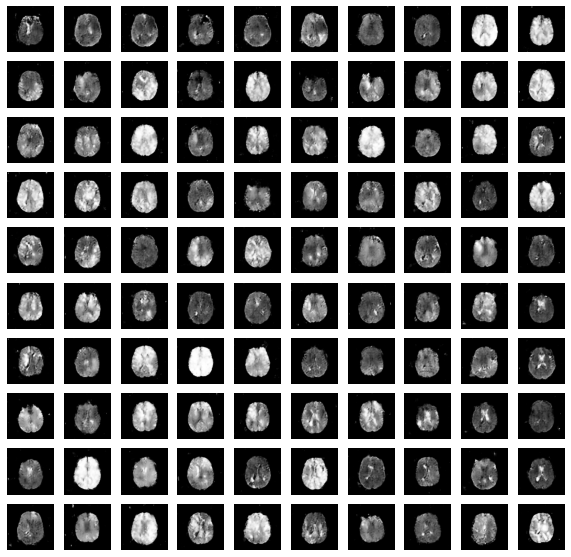

Generator loss: 
0.82868385
Discriminator loss: 
1.3435485
Time for epoch 43 is 70.16297674179077 sec


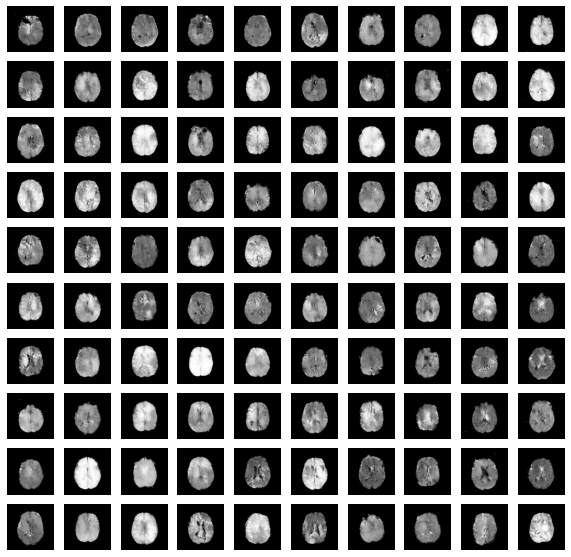

Generator loss: 
0.60983914
Discriminator loss: 
1.7886171
Time for epoch 44 is 70.39745473861694 sec


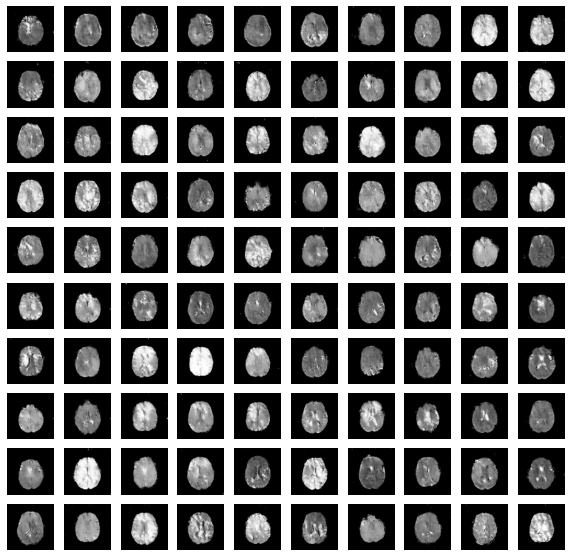

Generator loss: 
0.39495063
Discriminator loss: 
1.6786677
Time for epoch 45 is 70.24097228050232 sec


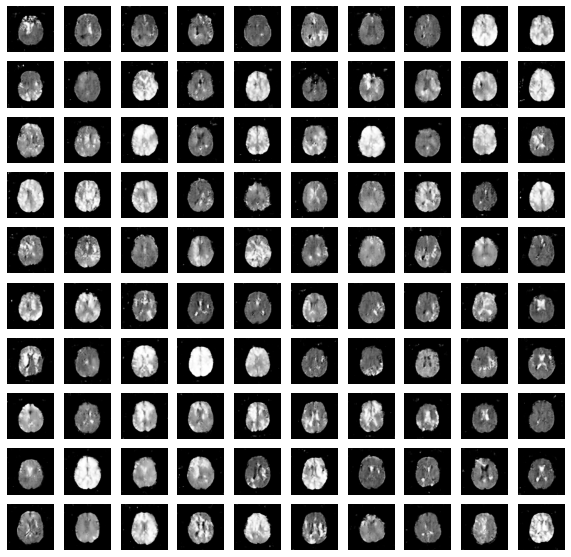

Generator loss: 
1.1817542
Discriminator loss: 
1.6444216
Time for epoch 46 is 70.35782718658447 sec


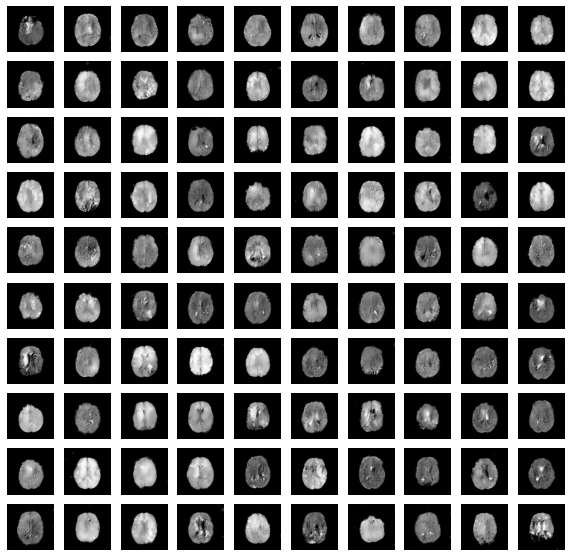

Generator loss: 
0.9264654
Discriminator loss: 
1.2025383
Time for epoch 47 is 70.2874002456665 sec


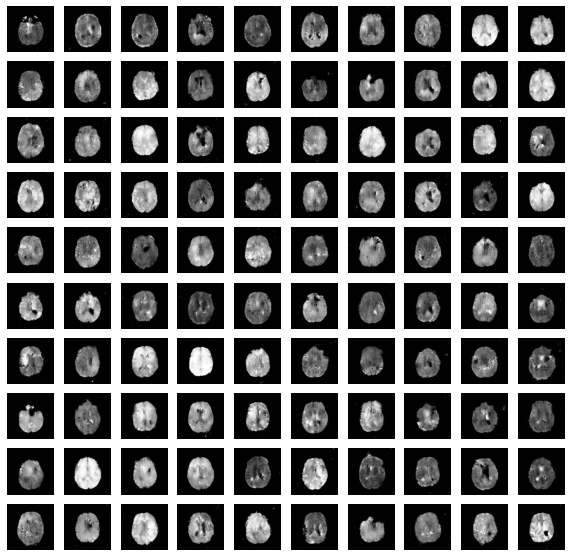

Generator loss: 
0.6889682
Discriminator loss: 
1.3135068
Time for epoch 48 is 70.42844223976135 sec


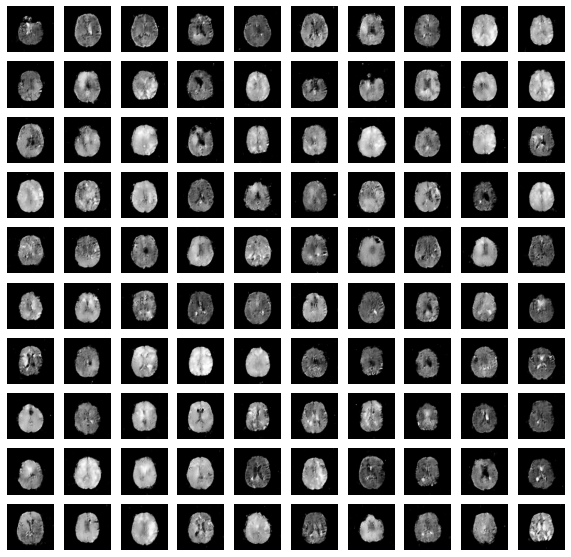

Generator loss: 
0.5316273
Discriminator loss: 
1.2552284
Time for epoch 49 is 70.25294375419617 sec


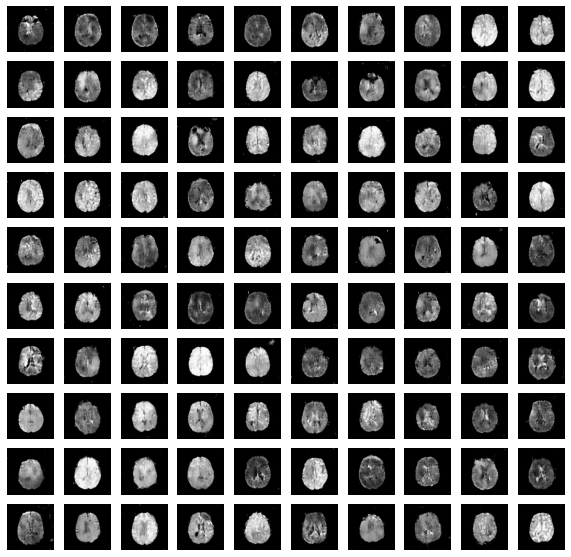

Generator loss: 
1.3385613
Discriminator loss: 
0.8999936
Time for epoch 50 is 70.22116494178772 sec


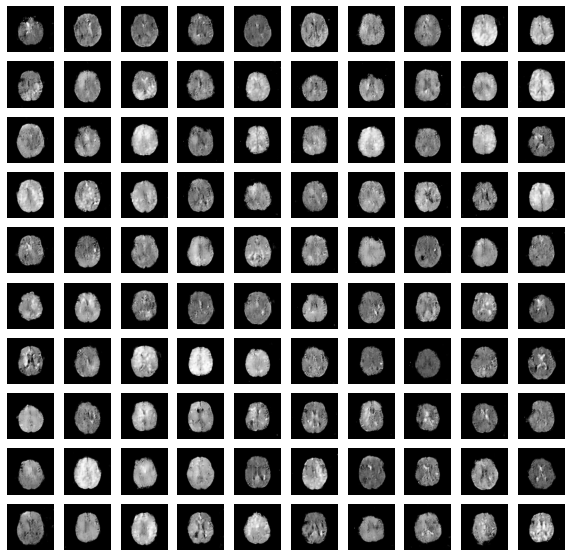

Generator loss: 
0.8527534
Discriminator loss: 
1.40215
Time for epoch 51 is 70.46726512908936 sec


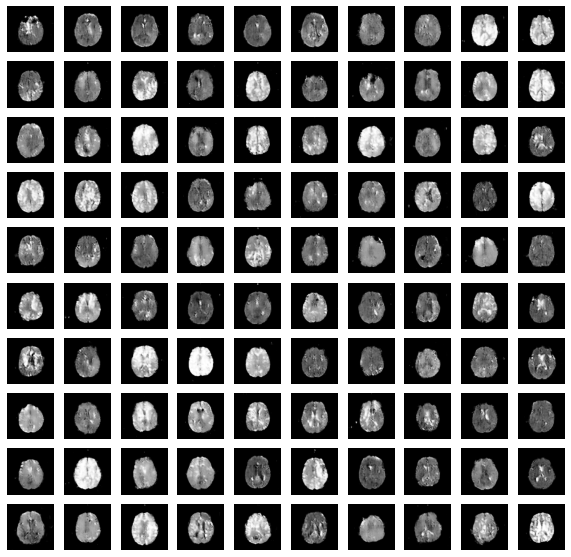

Generator loss: 
0.7673186
Discriminator loss: 
1.0964308
Time for epoch 52 is 70.52056574821472 sec


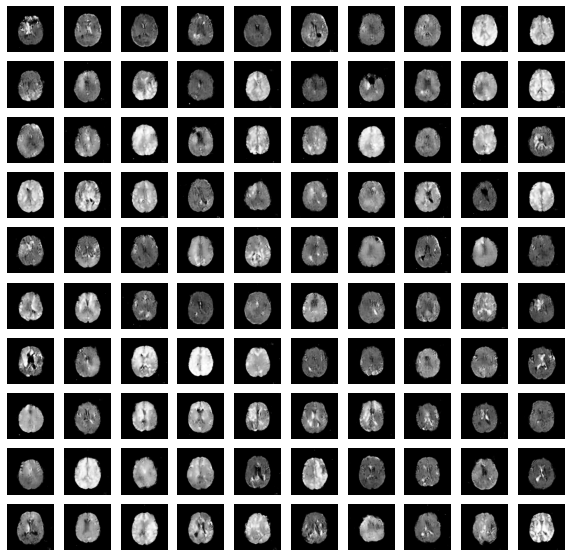

Generator loss: 
0.59868634
Discriminator loss: 
1.5224988
Time for epoch 53 is 70.3835666179657 sec


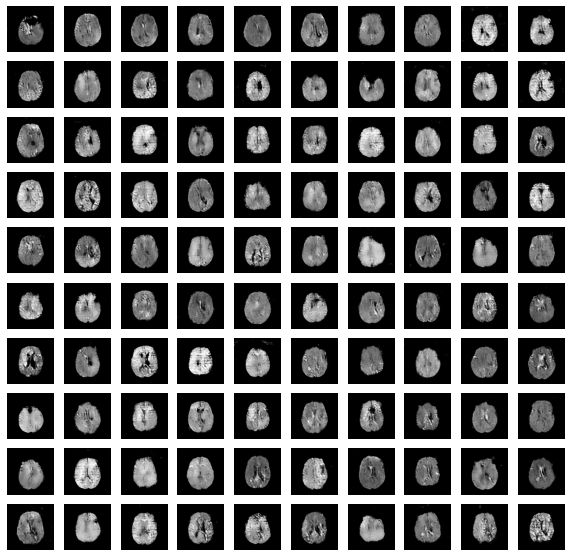

Generator loss: 
1.3290417
Discriminator loss: 
1.1476777
Time for epoch 54 is 70.22923064231873 sec


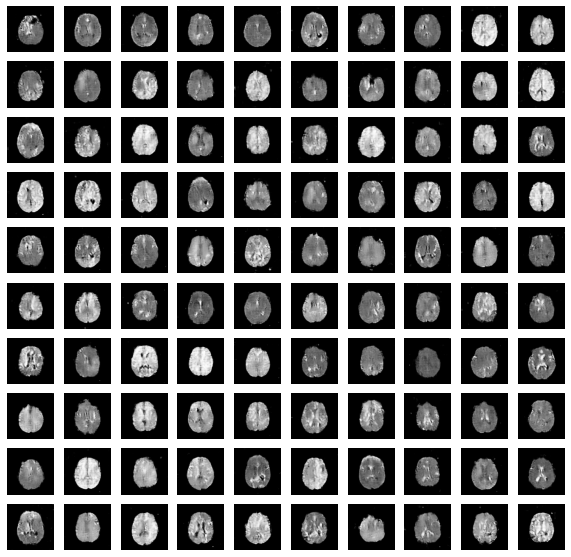

Generator loss: 
0.51400954
Discriminator loss: 
1.7848276
Time for epoch 55 is 70.35238194465637 sec


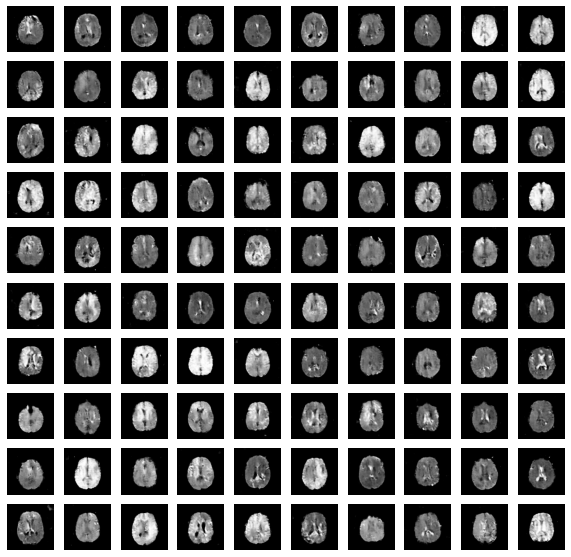

Generator loss: 
0.7379806
Discriminator loss: 
1.6011109
Time for epoch 56 is 70.38770651817322 sec


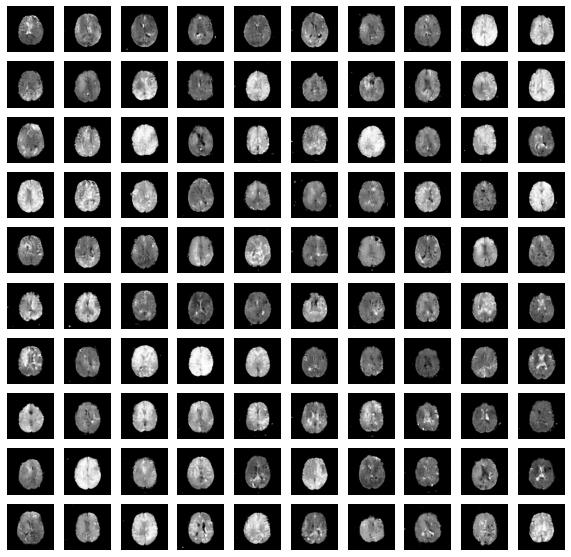

Generator loss: 
0.6659576
Discriminator loss: 
1.5439129
Time for epoch 57 is 70.17435121536255 sec


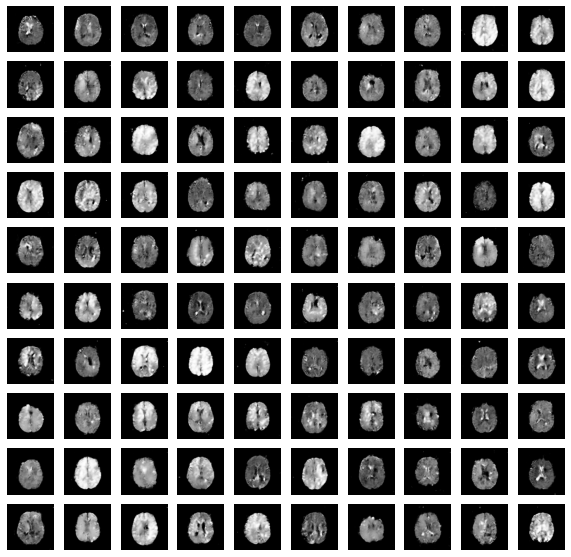

Generator loss: 
0.56597984
Discriminator loss: 
1.6053044
Time for epoch 58 is 70.3696928024292 sec


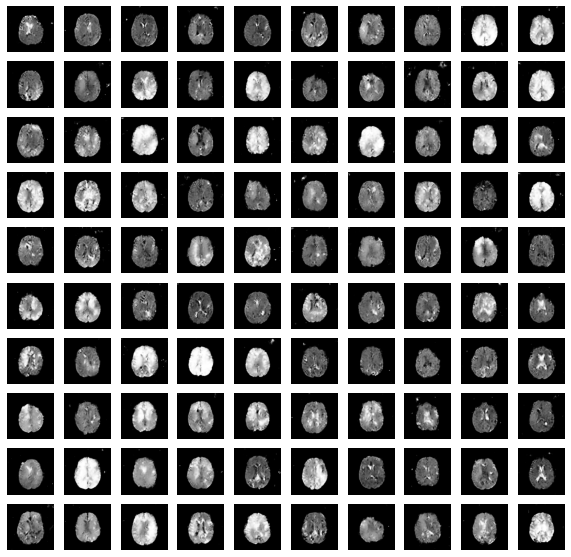

Generator loss: 
0.58819175
Discriminator loss: 
1.7397583
Time for epoch 59 is 70.20406985282898 sec


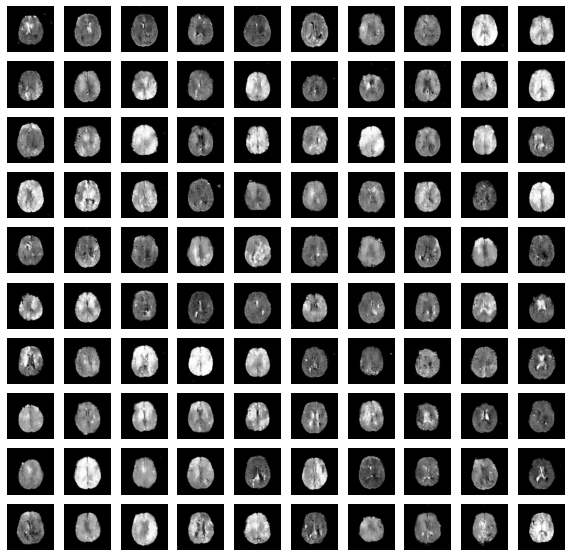

Generator loss: 
0.7017163
Discriminator loss: 
1.414247
Time for epoch 60 is 70.38008141517639 sec


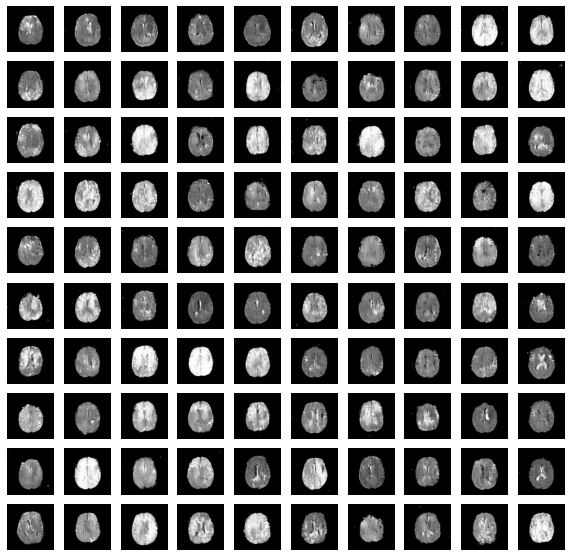

Generator loss: 
0.8453906
Discriminator loss: 
1.1134933
Time for epoch 61 is 70.22894191741943 sec


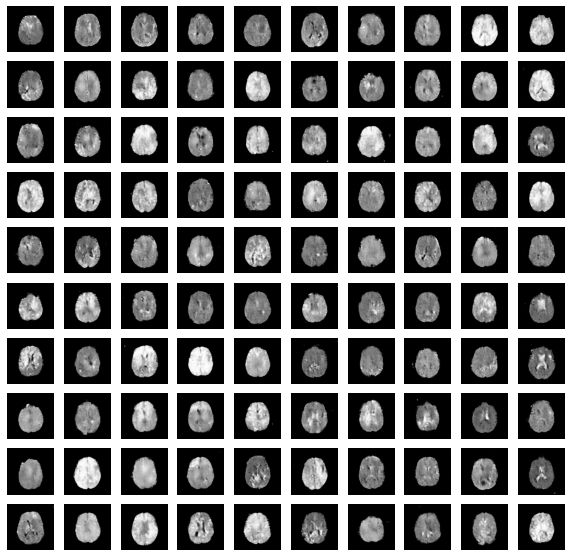

Generator loss: 
0.9556476
Discriminator loss: 
1.3124518
Time for epoch 62 is 70.34850668907166 sec


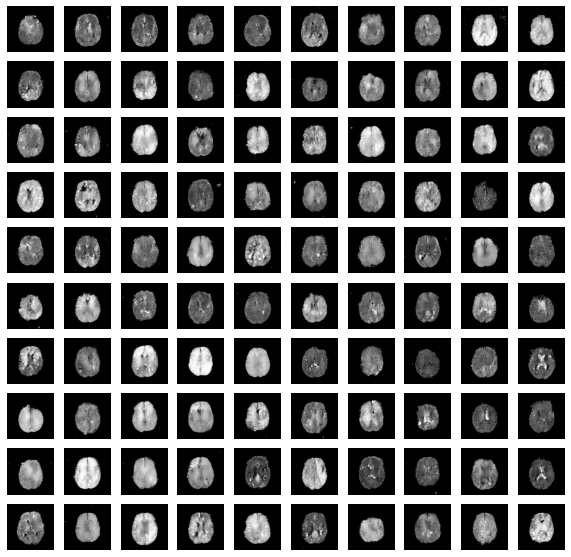

Generator loss: 
1.5690391
Discriminator loss: 
1.3332624
Time for epoch 63 is 70.22034406661987 sec


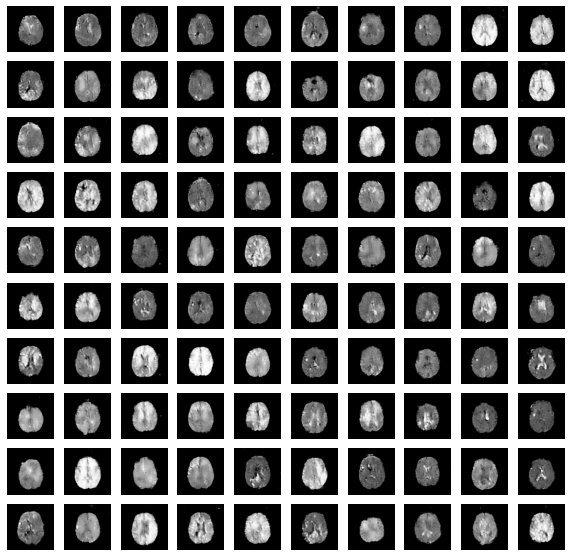

Generator loss: 
1.0142211
Discriminator loss: 
1.7430909
Time for epoch 64 is 70.14507508277893 sec


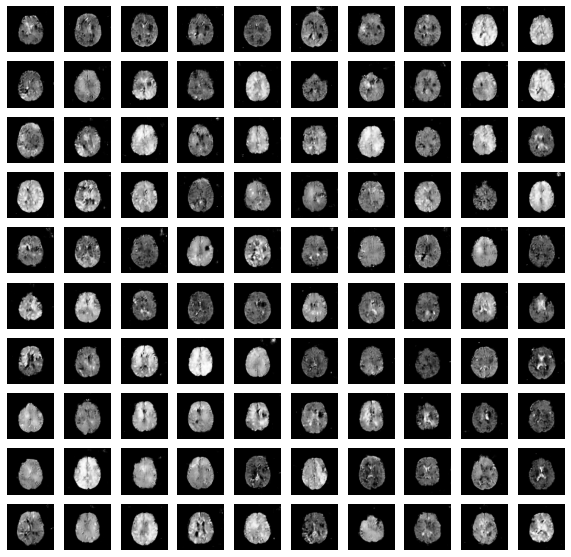

Generator loss: 
1.1193886
Discriminator loss: 
0.8348853
Time for epoch 65 is 70.34549689292908 sec


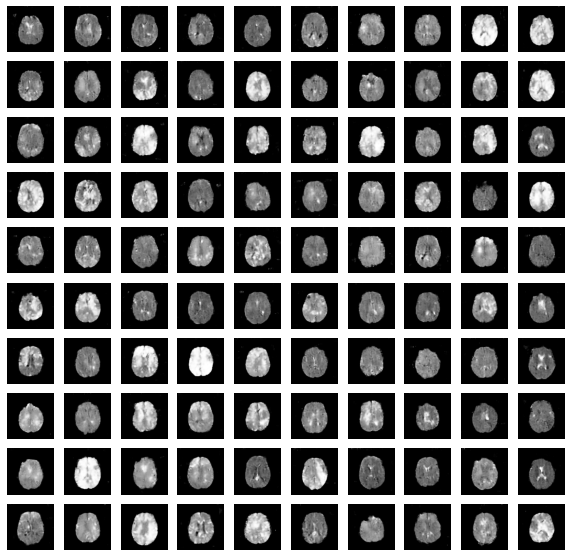

Generator loss: 
0.7048191
Discriminator loss: 
1.4648108
Time for epoch 66 is 70.09387373924255 sec


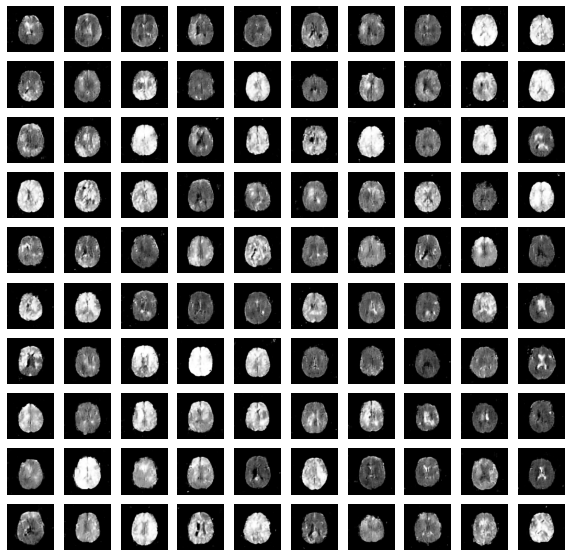

Generator loss: 
1.0312378
Discriminator loss: 
1.3031278
Time for epoch 67 is 70.4429223537445 sec


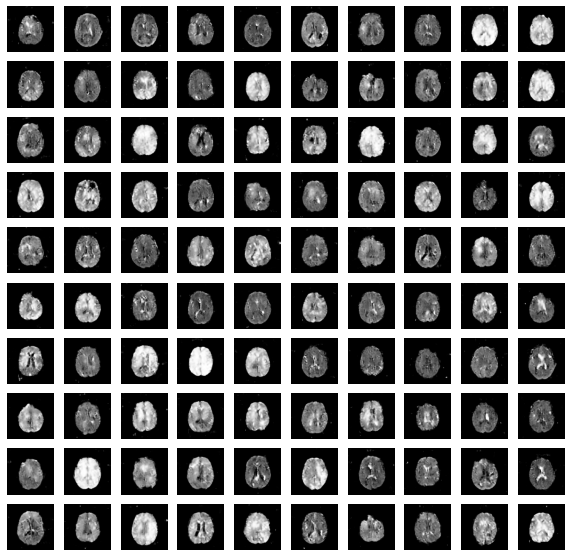

Generator loss: 
0.54420584
Discriminator loss: 
1.7419075
Time for epoch 68 is 70.19068264961243 sec


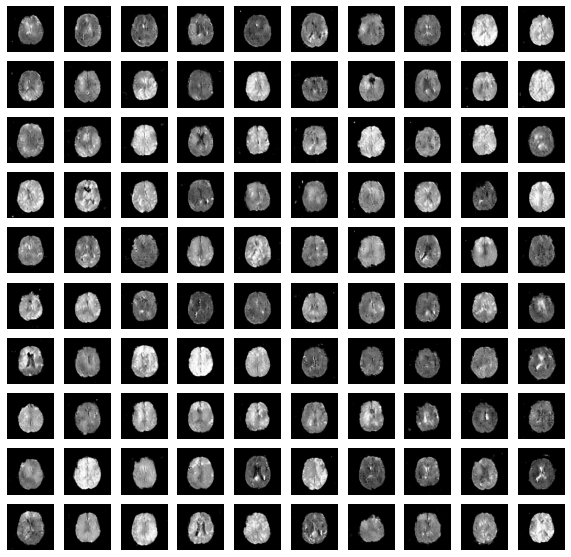

Generator loss: 
1.417913
Discriminator loss: 
1.1081517
Time for epoch 69 is 70.42999124526978 sec


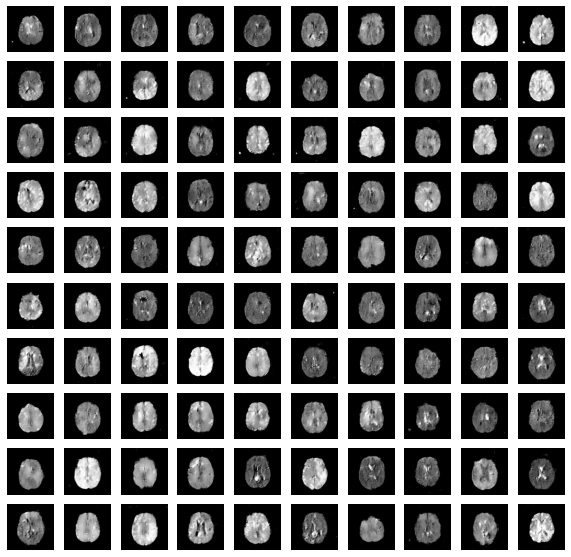

Generator loss: 
0.75209546
Discriminator loss: 
1.4889015
Time for epoch 70 is 70.1923553943634 sec


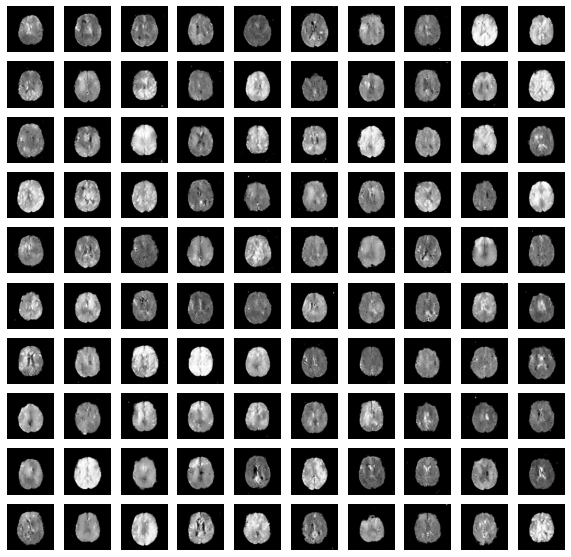

Generator loss: 
0.6171745
Discriminator loss: 
1.5826434
Time for epoch 71 is 70.22489833831787 sec


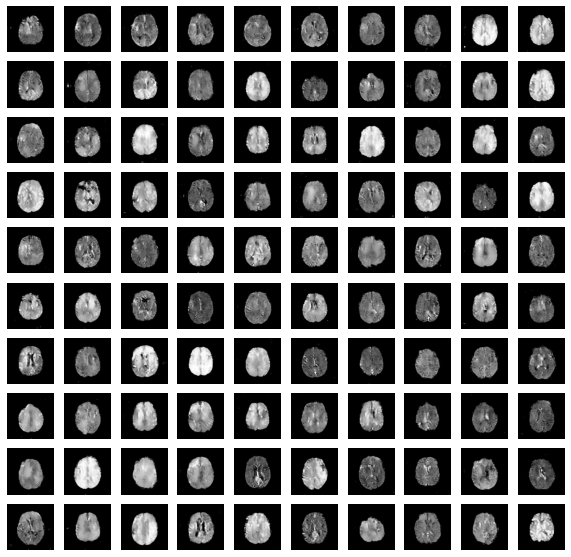

Generator loss: 
0.8965026
Discriminator loss: 
1.3667839
Time for epoch 72 is 70.3271005153656 sec


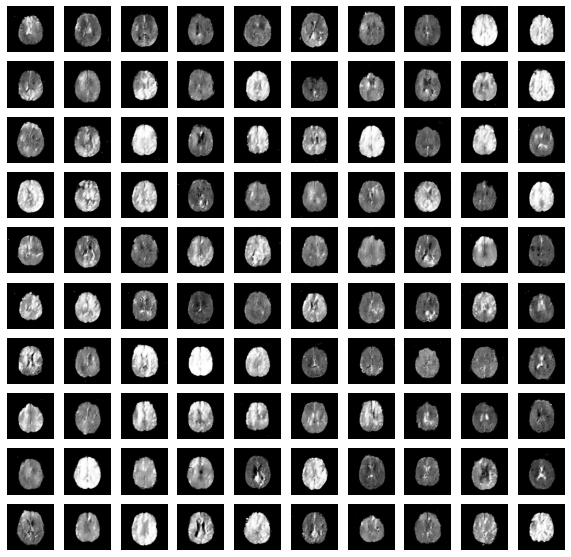

Generator loss: 
0.96694314
Discriminator loss: 
1.2812235
Time for epoch 73 is 70.20978212356567 sec


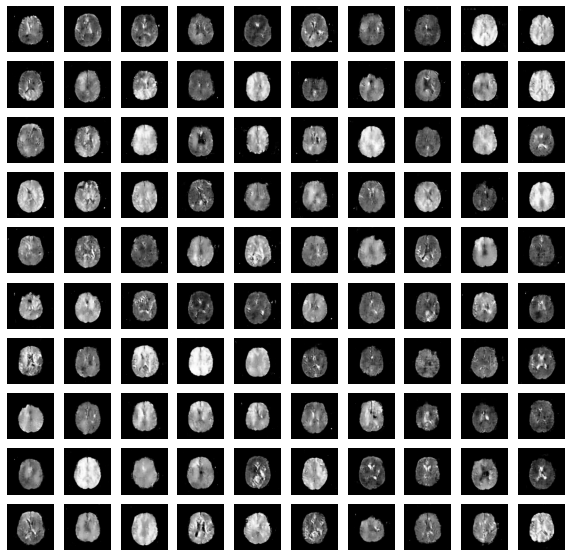

Generator loss: 
1.0249999
Discriminator loss: 
1.1887562
Time for epoch 74 is 70.34720015525818 sec


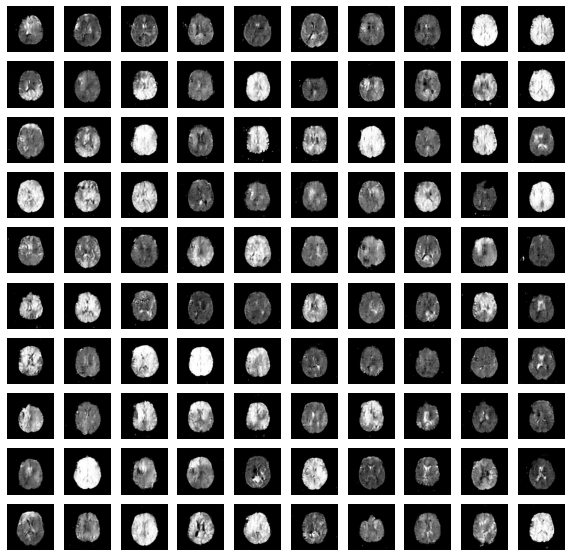

Generator loss: 
1.0036597
Discriminator loss: 
1.4142432
Time for epoch 75 is 70.2927508354187 sec


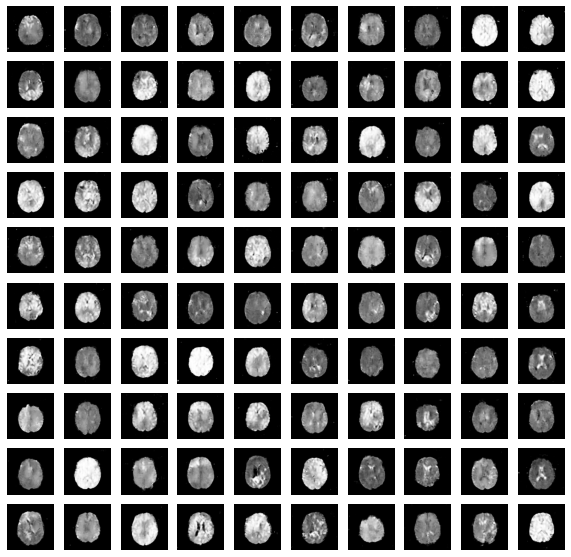

Generator loss: 
0.8299105
Discriminator loss: 
1.2985477
Time for epoch 76 is 71.50437259674072 sec


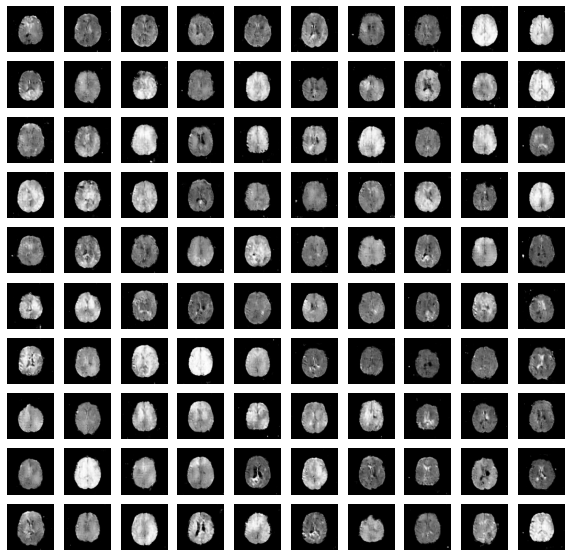

Generator loss: 
0.50565434
Discriminator loss: 
1.469405
Time for epoch 77 is 70.36436939239502 sec


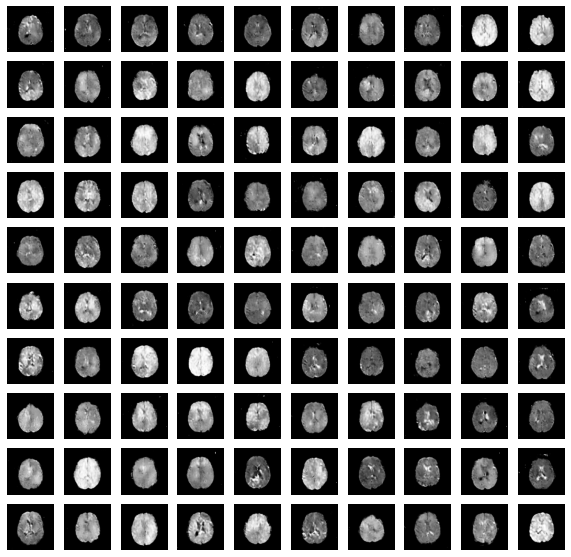

Generator loss: 
0.95534986
Discriminator loss: 
1.315224
Time for epoch 78 is 70.141925573349 sec


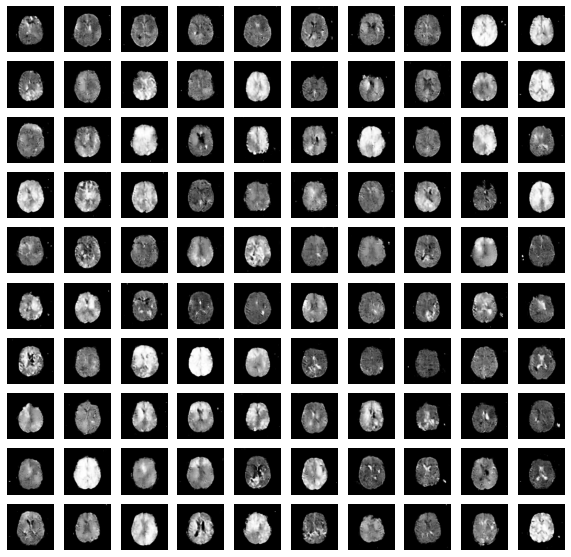

Generator loss: 
0.74646235
Discriminator loss: 
1.486943
Time for epoch 79 is 70.41261196136475 sec


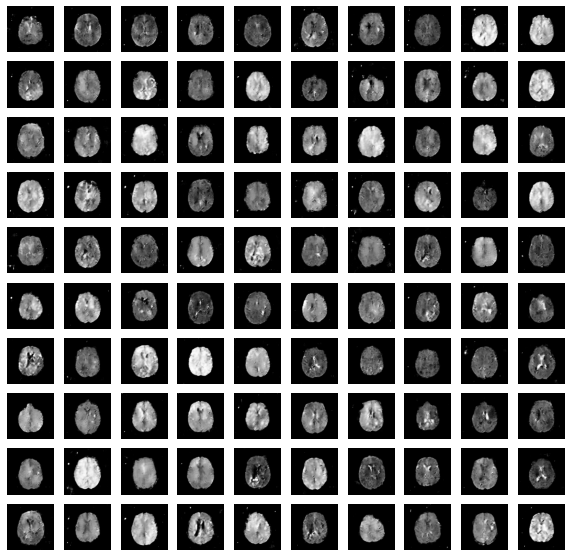

Generator loss: 
0.80456406
Discriminator loss: 
1.5853374
Time for epoch 80 is 70.2323157787323 sec


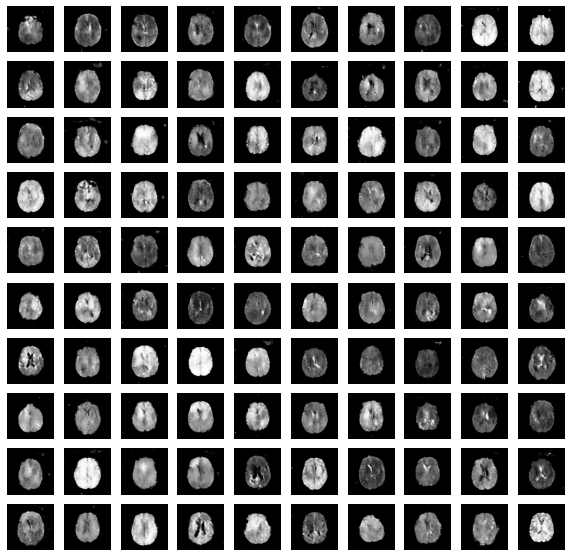

Generator loss: 
0.85904634
Discriminator loss: 
1.5214114
Time for epoch 81 is 70.37818956375122 sec


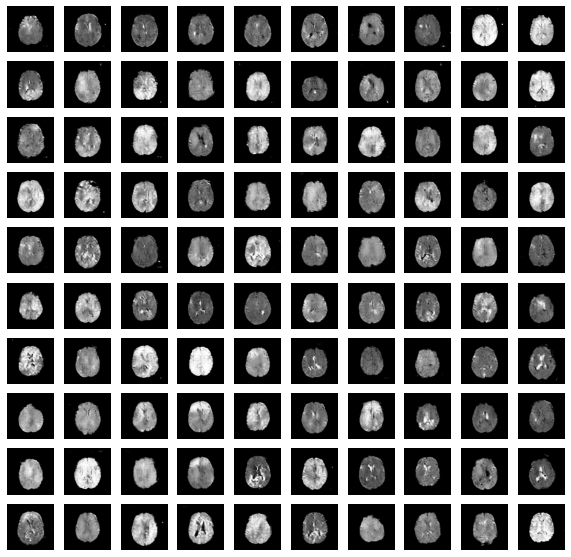

Generator loss: 
0.48707068
Discriminator loss: 
1.7752858
Time for epoch 82 is 70.28613376617432 sec


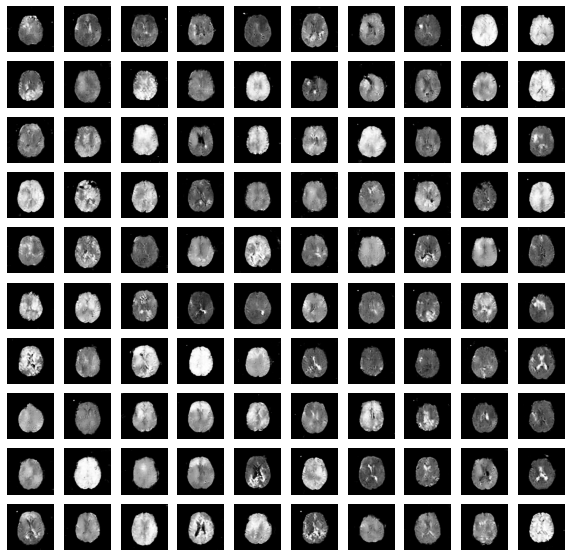

Generator loss: 
0.4795125
Discriminator loss: 
1.6132429
Time for epoch 83 is 70.46773910522461 sec


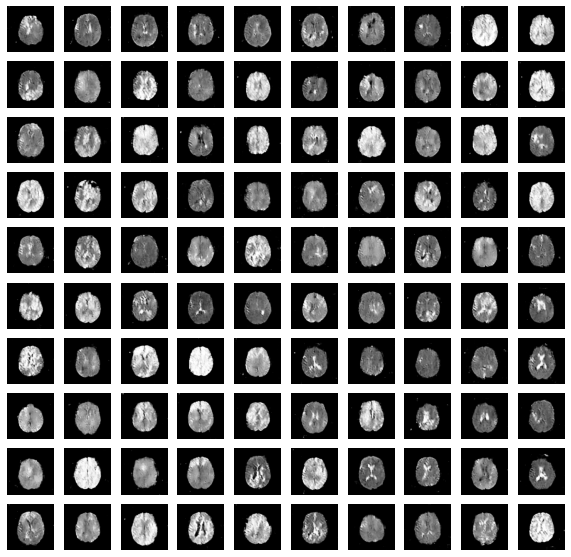

Generator loss: 
0.8861562
Discriminator loss: 
1.3602331
Time for epoch 84 is 70.28464984893799 sec


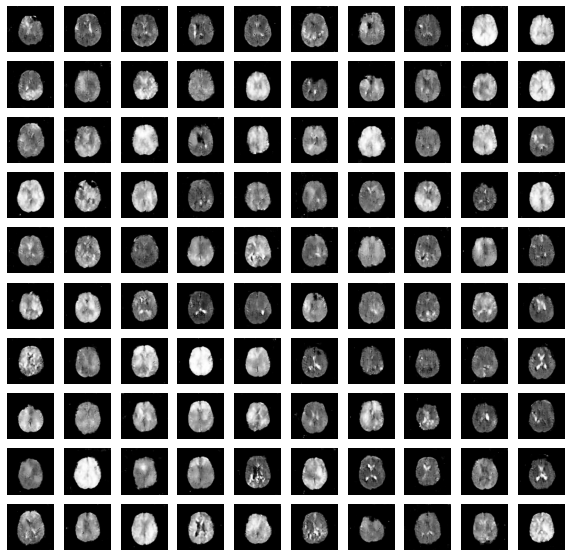

Generator loss: 
0.4574451
Discriminator loss: 
1.7757357
Time for epoch 85 is 70.24881839752197 sec


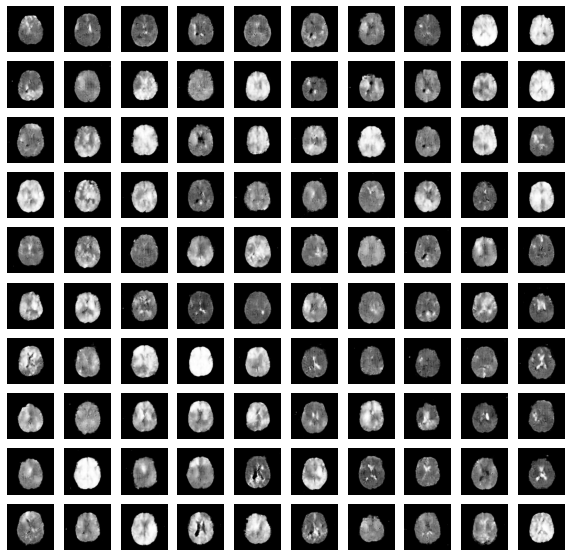

Generator loss: 
0.49002168
Discriminator loss: 
1.577553
Time for epoch 86 is 70.37845635414124 sec


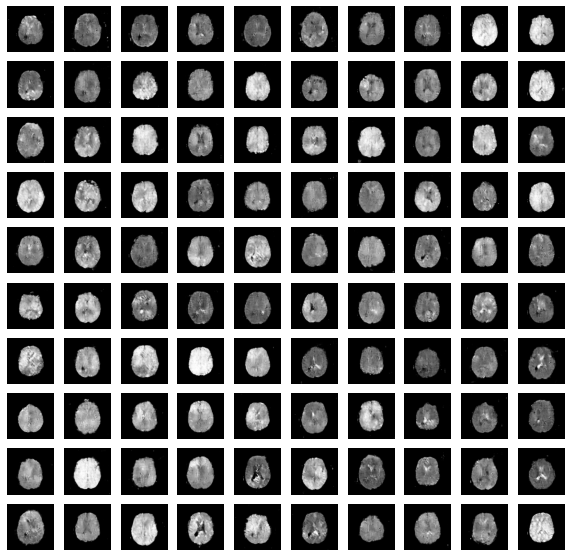

Generator loss: 
0.6636263
Discriminator loss: 
1.4437579
Time for epoch 87 is 70.32877564430237 sec


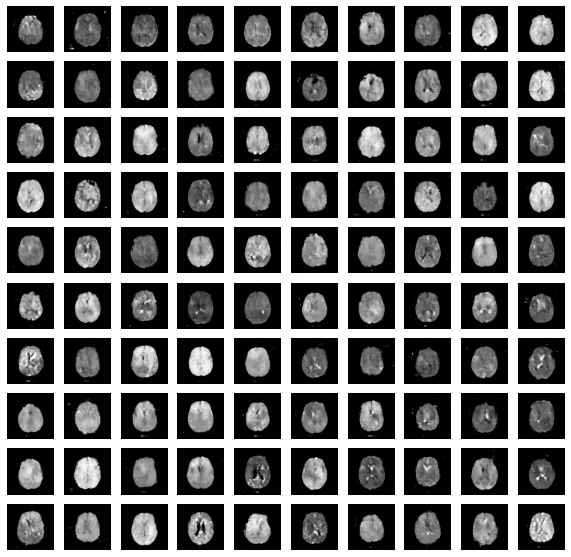

Generator loss: 
0.6152918
Discriminator loss: 
1.8276551
Time for epoch 88 is 84.65907907485962 sec


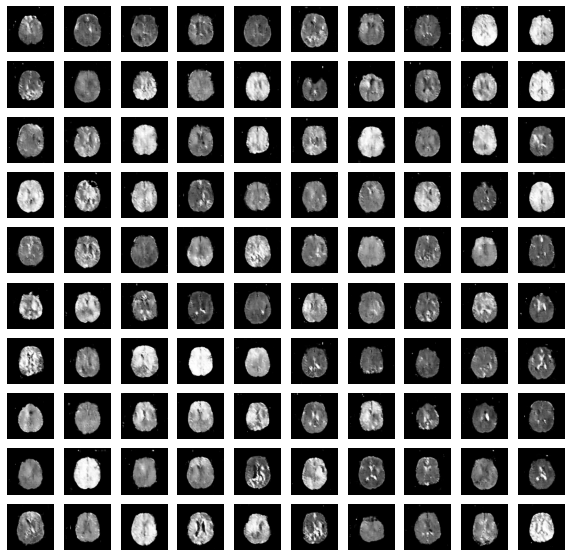

Generator loss: 
1.6584752
Discriminator loss: 
1.1922842
Time for epoch 89 is 71.03843998908997 sec


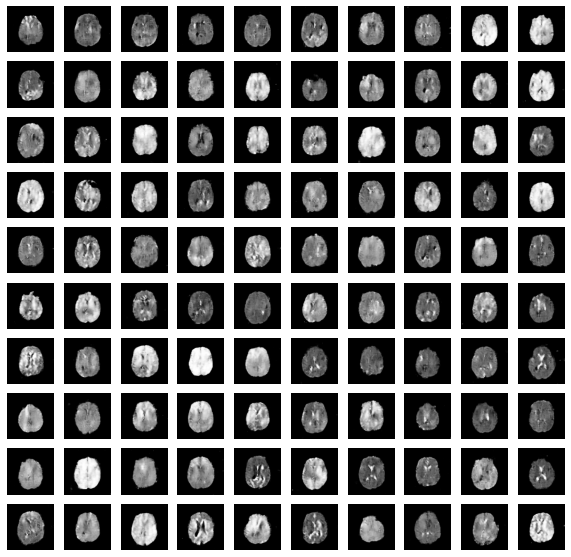

Generator loss: 
0.42671198
Discriminator loss: 
1.4245853
Time for epoch 90 is 70.48340773582458 sec


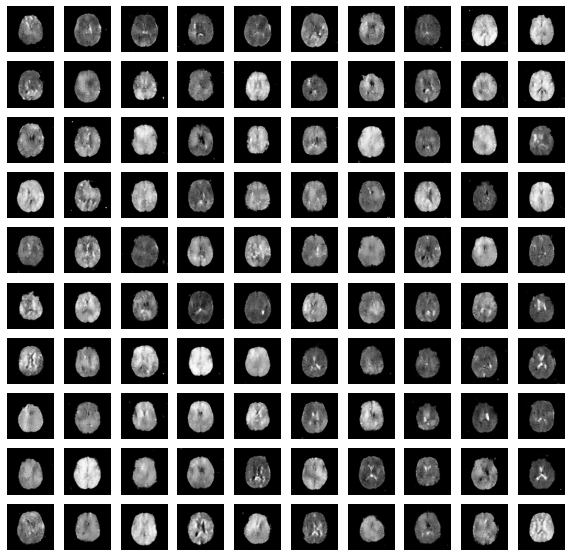

Generator loss: 
0.6418942
Discriminator loss: 
1.4912506
Time for epoch 91 is 70.18414759635925 sec


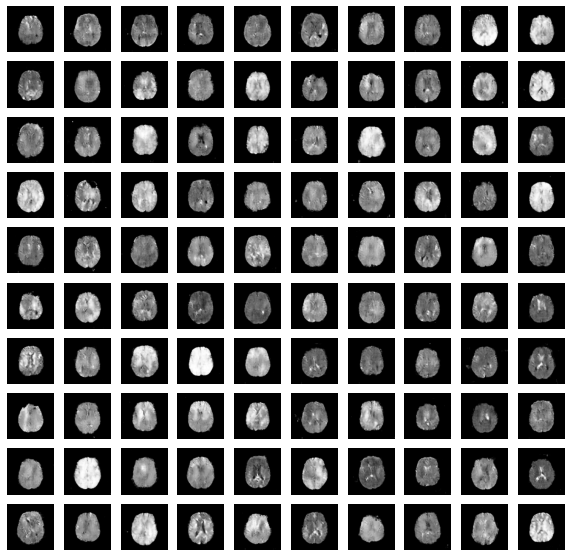

Generator loss: 
0.7459487
Discriminator loss: 
1.21399
Time for epoch 92 is 70.18513655662537 sec


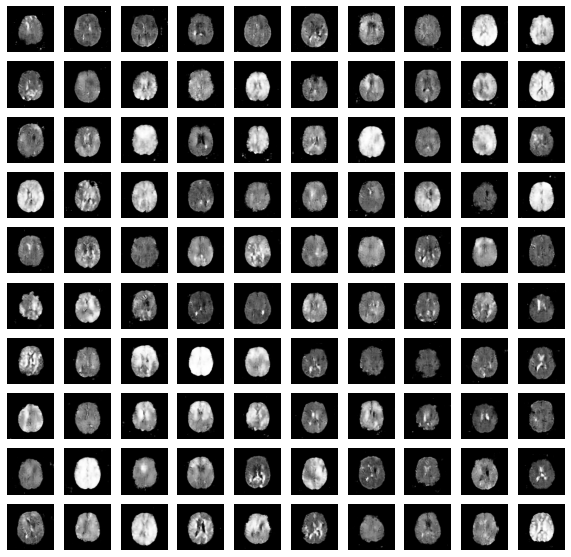

Generator loss: 
0.7630643
Discriminator loss: 
1.2617296
Time for epoch 93 is 70.41453909873962 sec


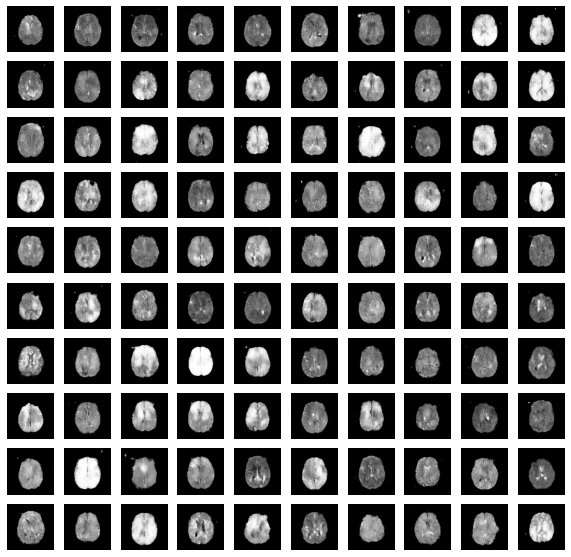

Generator loss: 
0.7669066
Discriminator loss: 
1.2209952
Time for epoch 94 is 70.32608294487 sec


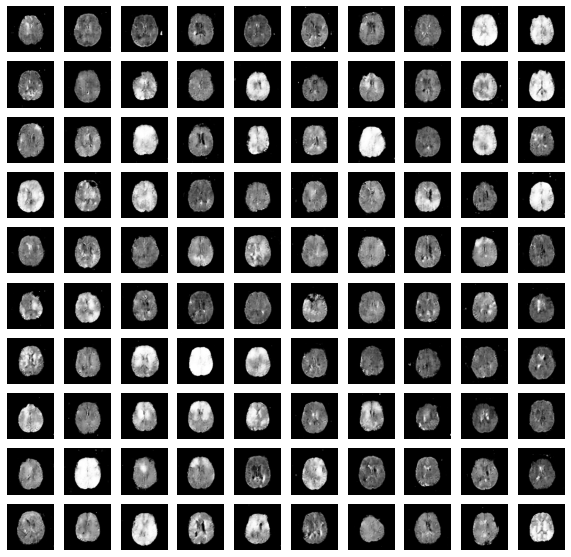

Generator loss: 
0.65886444
Discriminator loss: 
1.2234008
Time for epoch 95 is 70.40206623077393 sec


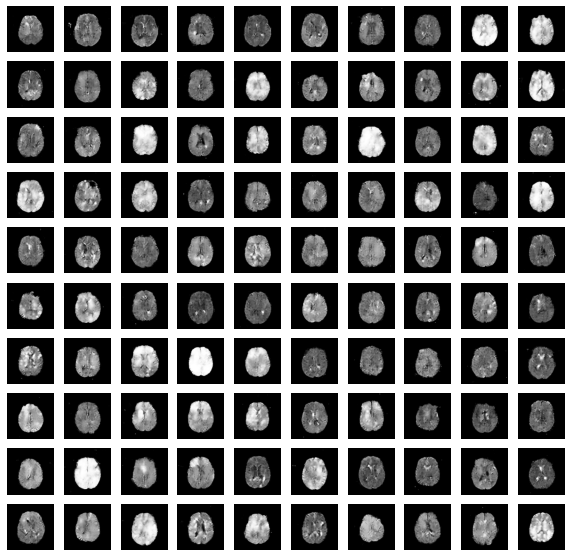

Generator loss: 
0.6549528
Discriminator loss: 
1.5679951
Time for epoch 96 is 70.24277567863464 sec


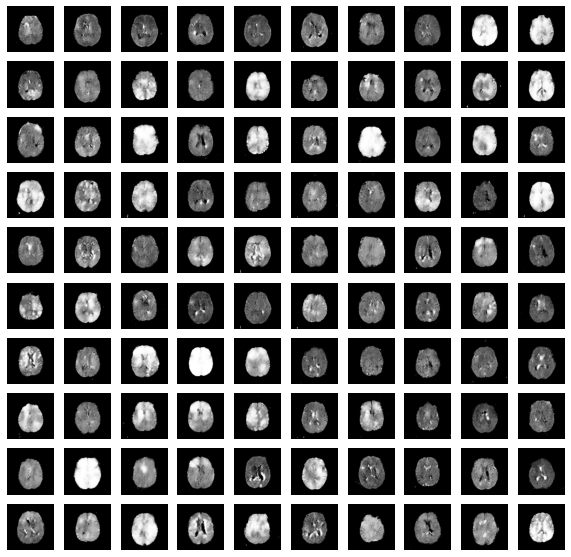

Generator loss: 
0.55530894
Discriminator loss: 
1.4871807
Time for epoch 97 is 70.40536618232727 sec


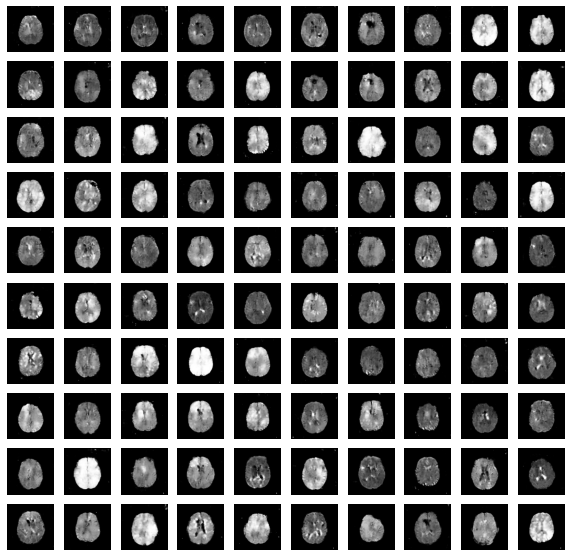

Generator loss: 
0.84095335
Discriminator loss: 
1.4072578
Time for epoch 98 is 70.27099990844727 sec


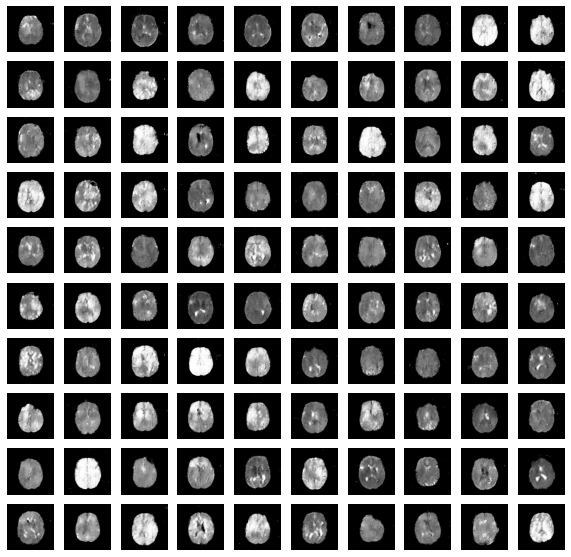

Generator loss: 
0.8287746
Discriminator loss: 
1.4519173
Time for epoch 99 is 70.18918681144714 sec


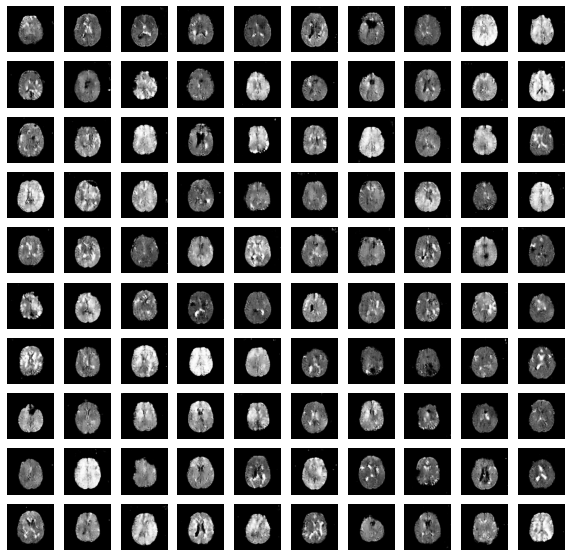

Generator loss: 
0.5167454
Discriminator loss: 
1.7184744
Time for epoch 100 is 70.3827497959137 sec


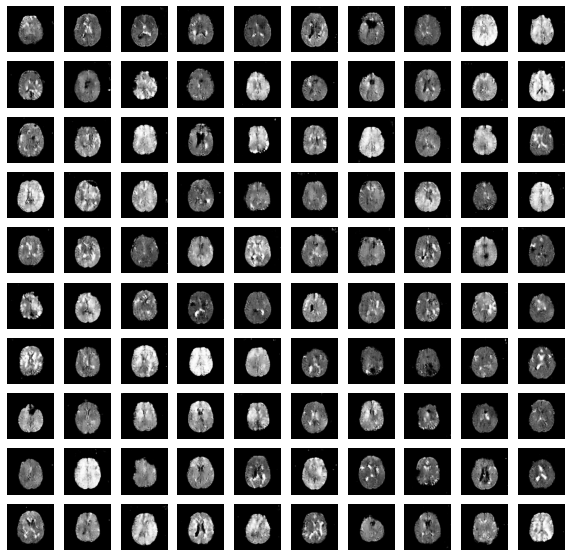

In [28]:
EPOCHS = 100
gen_loss_array, disc_loss_array = train(train_dataset, EPOCHS)

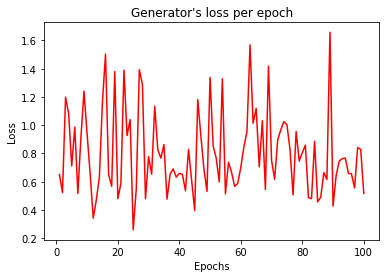

In [29]:
plt.title("Generator's loss per epoch")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.plot(range(1, EPOCHS + 1), gen_loss_array, color ="red")
plt.show()

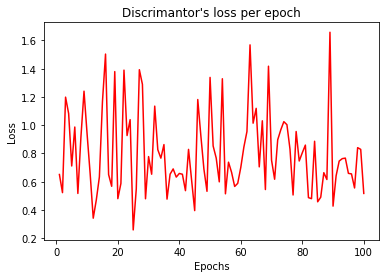

In [30]:
plt.title("Discrimantor's loss per epoch")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.plot(range(1, EPOCHS + 1), gen_loss_array, color ="red")
plt.show()

In [ ]:
generator.save('/content/drive/MyDrive/UAB/TFG/models/generator-20000samples-100epochs')
discriminator.save('/content/drive/MyDrive/UAB/TFG/models/discriminator-20000samples-100epochs')

In [31]:
def generate_images(model, test_input):

  predictions = model(test_input, training=False)

  fig = plt.figure(figsize=(grid_size_x,grid_size_y))
  for i in range(predictions.shape[0]):
      plt.subplot(grid_size_x, grid_size_y, i+1)
      plt.imshow(predictions[i, :, :, 0] * 127.5 + 127.5, cmap='gray')
      plt.axis('off')
  
  plt.show()

  return predictions


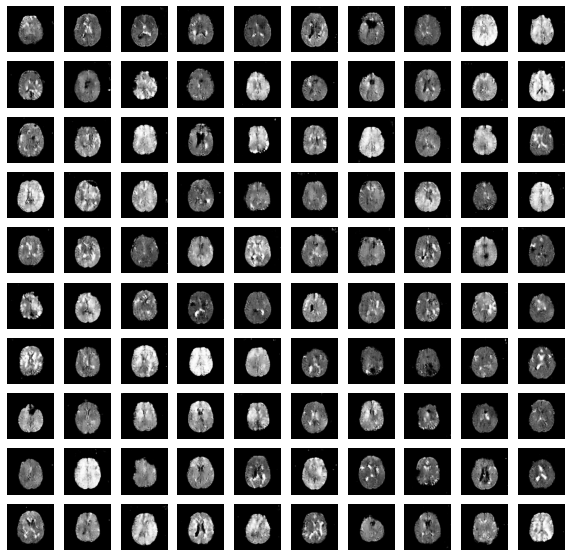

In [32]:
pred =  generate_images(generator, seed)

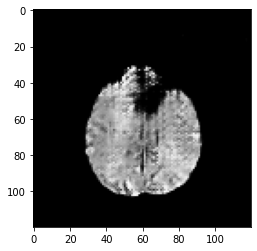

In [33]:
plt.imshow(pred[70, :, :, 0] * 127.5 + 127.5, cmap='gray')

In [ ]:
# BORRADOR
gen_loss_array = np.zeros([100], dtype=float)
gen_loss_array[0] = 0.5
gen_loss_array